### Importing Libraries and Setting Up Environment

In [81]:
import pandas as pd
import numpy as np
import matplotlib.pylab as plt
import seaborn as sns
plt.style.use('ggplot')
pd.set_option('display.max_columns', 200)

# Preprocessing and scaling
from sklearn.preprocessing import StandardScaler

# Model imports
from sklearn.cluster import KMeans
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from xgboost import XGBRegressor, XGBClassifier
from sklearn.neighbors import KNeighborsClassifier

# Model evaluation and selection
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.metrics import (
    confusion_matrix, ConfusionMatrixDisplay, accuracy_score, precision_score,
    recall_score, f1_score, roc_auc_score, roc_curve, classification_report
)

# Tools from `dmba` package
from dmba import (
    classificationSummary, regressionSummary, plotDecisionTree,
    gainsChart, liftChart, exhaustive_search,
    backward_elimination, forward_selection, stepwise_selection,
    adjusted_r2_score, AIC_score, BIC_score
)

# Other utilities
from sklearn.metrics import mean_absolute_error


In [25]:
%matplotlib inline


### Loading Data

In [2]:
path = "/Users/osheen/Desktop/MSBA/2nd Term/BA competition/SBAnational.csv"
df = pd.read_csv(path)

/var/folders/wp/7gj1l4js36x19385y937b37c0000gn/T/ipykernel_46400/2275461996.py:2: DtypeWarning: Columns (9) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(path)


In [3]:
df.shape

(899164, 27)

### Initial Data Inspection

In [4]:
df.head()

,LoanNr_ChkDgt,Name,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,SBA_Appv
0,1000014003,ABC HOBBYCRAFT,EVANSVILLE,IN,47711,FIFTH THIRD BANK,OH,451120,28-Feb-97,1997,84,4,2.0,0,0,1,0,N,Y,NaN,28-Feb-99,"$60,000.00",$0.00,P I F,$0.00,"$60,000.00","$48,000.00"
1,1000024006,LANDMARK BAR & GRILLE (THE),NEW PARIS,IN,46526,1ST SOURCE BANK,IN,722410,28-Feb-97,1997,60,2,2.0,0,0,1,0,N,Y,NaN,31-May-97,"$40,000.00",$0.00,P I F,$0.00,"$40,000.00","$32,000.00"
2,1000034009,"WHITLOCK DDS, TODD M.",BLOOMINGTON,IN,47401,GRANT COUNTY STATE BANK,IN,621210,28-Feb-97,1997,180,7,1.0,0,0,1,0,N,N,NaN,31-Dec-97,"$287,000.00",$0.00,P I F,$0.00,"$287,000.00","$215,250.00"
3,1000044001,"BIG BUCKS PAWN & JEWELRY, LLC",BROKEN ARROW,OK,74012,1ST NATL BK & TR CO OF BROKEN,OK,0,28-Feb-97,1997,60,2,1.0,0,0,1,0,N,Y,NaN,30-Jun-97,"$35,000.00",$0.00,P I F,$0.00,"$35,000.00","$28,000.00"
4,1000054004,"ANASTASIA CONFECTIONS, INC.",ORLANDO,FL,32801,FLORIDA BUS. DEVEL CORP,FL,0,28-Feb-97,1997,240,14,1.0,7,7,1,0,N,N,NaN,14-May-97,"$229,000.00",$0.00,P I F,$0.00,"$229,000.00","$229,000.00"


In [5]:
df.columns

Index(['LoanNr_ChkDgt', 'Name', 'City', 'State', 'Zip', 'Bank', 'BankState',
       'NAICS', 'ApprovalDate', 'ApprovalFY', 'Term', 'NoEmp', 'NewExist',
       'CreateJob', 'RetainedJob', 'FranchiseCode', 'UrbanRural', 'RevLineCr',
       'LowDoc', 'ChgOffDate', 'DisbursementDate', 'DisbursementGross',
       'BalanceGross', 'MIS_Status', 'ChgOffPrinGr', 'GrAppv', 'SBA_Appv'],
      dtype='object')

In [6]:
df.dtypes

LoanNr_ChkDgt          int64
Name                  object
City                  object
State                 object
Zip                    int64
Bank                  object
BankState             object
NAICS                  int64
ApprovalDate          object
ApprovalFY            object
Term                   int64
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr             object
LowDoc                object
ChgOffDate            object
DisbursementDate      object
DisbursementGross     object
BalanceGross          object
MIS_Status            object
ChgOffPrinGr          object
GrAppv                object
SBA_Appv              object
dtype: object

### Dataset Overview

In [9]:
df.describe(include='all')

,LoanNr_ChkDgt,Name,City,State,Zip,Bank,BankState,NAICS,ApprovalDate,ApprovalFY,Term,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,MIS_Status,ChgOffPrinGr,GrAppv,SBA_Appv
count,8.991640e+05,899150,899134,899150,899164.000000,897605,897598,899164.000000,899164,899164.0,899164.000000,899164.000000,899028.000000,899164.000000,899164.000000,899164.000000,899164.000000,894636,896582,162699,896796,899164,899164,897167,899164,899164,899164
unique,NaN,779583,32581,51,NaN,5802,56,NaN,9859,70.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,8,6448,8472,118859,15,2,83165,22128,38326
top,NaN,SUBWAY,LOS ANGELES,CA,NaN,BANK OF AMERICA NATL ASSOC,CA,NaN,7-Jul-93,2006.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,N,13-Mar-10,31-Jul-95,"$50,000.00",$0.00,P I F,$0.00,"$50,000.00","$25,000.00"
freq,NaN,1269,11558,130619,NaN,86853,118116,NaN,1131,76040.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,420288,782822,734,10371,43787,899150,739609,737152,69394,49579
mean,4.772612e+09,NaN,NaN,NaN,53804.391241,NaN,NaN,398660.950146,NaN,NaN,110.773078,11.411353,1.280404,8.430376,10.797257,2753.725933,0.757748,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,2.538175e+09,NaN,NaN,NaN,31184.159152,NaN,NaN,263318.312759,NaN,NaN,78.857305,74.108196,0.451750,236.688165,237.120600,12758.019136,0.646436,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,1.000014e+09,NaN,NaN,NaN,0.000000,NaN,NaN,0.000000,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,2.589758e+09,NaN,NaN,NaN,27587.000000,NaN,NaN,235210.000000,NaN,NaN,60.000000,2.000000,1.000000,0.000000,0.000000,1.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,4.361439e+09,NaN,NaN,NaN,55410.000000,NaN,NaN,445310.000000,NaN,NaN,84.000000,4.000000,1.000000,0.000000,1.000000,1.000000,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,6.904627e+09,NaN,NaN,NaN,83704.000000,NaN,NaN,561730.000000,NaN,NaN,120.000000,10.000000,2.000000,1.000000,4.000000,1.000000,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Data Cleaning and Feature Selection

In [43]:
df_new = df[[
    #'LoanNr_ChkDgt', 'Name', 'City', 
    'State', 
    #'Zip', 'Bank', 'BankState',
       'NAICS', 
       #'ApprovalDate', 'ApprovalFY', 
       'Term', 
       'NoEmp', 'NewExist', 
       #'CreateJob', 'RetainedJob', 
       #'FranchiseCode', 'UrbanRural', 'RevLineCr',
       #'LowDoc', 'ChgOffDate', 
       'DisbursementDate', 
       'DisbursementGross','BalanceGross', 'MIS_Status',
       #'ChgOffPrinGr', 
       'GrAppv', 'SBA_Appv'
       ]].copy()

In [44]:
df_new.shape

(899164, 11)

In [45]:
df_new2 = df_new.dropna()

In [46]:
df_new2.shape

(894845, 11)

In [47]:
df_new2.head(20)

,State,NAICS,Term,NoEmp,NewExist,DisbursementDate,DisbursementGross,BalanceGross,MIS_Status,GrAppv,SBA_Appv
0,IN,451120,84,4,2.0,28-Feb-99,"$60,000.00",$0.00,P I F,"$60,000.00","$48,000.00"
1,IN,722410,60,2,2.0,31-May-97,"$40,000.00",$0.00,P I F,"$40,000.00","$32,000.00"
2,IN,621210,180,7,1.0,31-Dec-97,"$287,000.00",$0.00,P I F,"$287,000.00","$215,250.00"
3,OK,0,60,2,1.0,30-Jun-97,"$35,000.00",$0.00,P I F,"$35,000.00","$28,000.00"
4,FL,0,240,14,1.0,14-May-97,"$229,000.00",$0.00,P I F,"$229,000.00","$229,000.00"
5,CT,332721,120,19,1.0,30-Jun-97,"$517,000.00",$0.00,P I F,"$517,000.00","$387,750.00"
6,NJ,0,45,45,2.0,22-Jul-80,"$600,000.00",$0.00,CHGOFF,"$600,000.00","$499,998.00"
7,FL,811118,84,1,2.0,30-Jun-98,"$45,000.00",$0.00,P I F,"$45,000.00","$36,000.00"
8,FL,721310,297,2,2.0,31-Jul-97,"$305,000.00",$0.00,P I F,"$305,000.00","$228,750.00"
9,CT,0,84,3,2.0,30-Apr-97,"$70,000.00",$0.00,P I F,"$70,000.00","$56,000.00"


In [48]:
df_new2 = df_new2[df_new2['NAICS'] != 0]


In [49]:
df_new2.shape

(693481, 11)

In [50]:
df_new2.head(10)

,State,NAICS,Term,NoEmp,NewExist,DisbursementDate,DisbursementGross,BalanceGross,MIS_Status,GrAppv,SBA_Appv
0,IN,451120,84,4,2.0,28-Feb-99,"$60,000.00",$0.00,P I F,"$60,000.00","$48,000.00"
1,IN,722410,60,2,2.0,31-May-97,"$40,000.00",$0.00,P I F,"$40,000.00","$32,000.00"
2,IN,621210,180,7,1.0,31-Dec-97,"$287,000.00",$0.00,P I F,"$287,000.00","$215,250.00"
5,CT,332721,120,19,1.0,30-Jun-97,"$517,000.00",$0.00,P I F,"$517,000.00","$387,750.00"
7,FL,811118,84,1,2.0,30-Jun-98,"$45,000.00",$0.00,P I F,"$45,000.00","$36,000.00"
8,FL,721310,297,2,2.0,31-Jul-97,"$305,000.00",$0.00,P I F,"$305,000.00","$228,750.00"
10,NC,811111,84,1,2.0,23-Feb-98,"$70,000.00",$0.00,P I F,"$70,000.00","$56,000.00"
11,IL,235950,60,24,1.0,30-Nov-97,"$150,000.00",$0.00,P I F,"$300,000.00","$225,000.00"
12,NC,445299,162,2,2.0,31-Mar-06,"$253,400.00",$0.00,P I F,"$253,400.00","$190,050.00"
15,OK,421330,12,5,2.0,30-Sep-97,"$350,000.00",$0.00,P I F,"$350,000.00","$262,500.00"


In [51]:
df_new2.shape

(693481, 11)

In [126]:
df_f = df_new2.copy()

df_f['Default'] = (df_f['MIS_Status'] == 'CHGOFF').astype(int)

# Remove dollar signs and commas, then convert the columns to numeric
df_f['DisbursementGross'] = df_f['DisbursementGross'].replace({'\$': '', ',': ''}, regex=True)
df_f['BalanceGross'] = df_f['BalanceGross'].replace({'\$': '', ',': ''}, regex=True)
df_f['GrAppv'] = df_f['GrAppv'].replace({'\$': '', ',': ''}, regex=True)
df_f['SBA_Appv'] = df_f['SBA_Appv'].replace({'\$': '', ',': ''}, regex=True)

# Convert the cleaned columns to numeric (force errors to NaN if any issues)
df_f['DisbursementGross'] = pd.to_numeric(df_f['DisbursementGross'], errors='coerce')
df_f['BalanceGross'] = pd.to_numeric(df_f['BalanceGross'], errors='coerce')
df_f['GrAppv'] = pd.to_numeric(df_f['GrAppv'], errors='coerce')
df_f['SBA_Appv'] = pd.to_numeric(df_f['SBA_Appv'], errors='coerce')

# Add a new column 'Backed_by_real_estate' based on the condition
df_f['Backed_by_real_estate'] = df_f['Term'].apply(lambda x: 1 if x >= 240 else 0)

# Preview the DataFrame
#print(df_f[['Term', 'Backed_by_real_estate']].head())

# Ensure 'DisbursementDate' is in datetime format
df_f['DisbursementDate'] = pd.to_datetime(df_f['DisbursementDate'], format='%d-%b-%y')

# Create the 'Recession' column directly using conditions
df_f['Recession'] = ((df_f['DisbursementDate'].dt.year >= 2007) & 
                     (df_f['DisbursementDate'].dt.year <= 2009)).astype(int)

# Now create the new variable 'Portion %'
df_f['Portion_%'] = df_f['SBA_Appv'] / df_f['GrAppv']

# Extract the first 2 digits of the NAICS code and create a new column
df_f['NAICS_2'] = df_f['NAICS'].astype(str).str[:2]

# Display the updated DataFrame
#print(df_f[['NAICS', 'NAICS_2']].head(20))

In [127]:
df_f.head(10)

,State,NAICS,Term,NoEmp,NewExist,DisbursementDate,DisbursementGross,BalanceGross,MIS_Status,GrAppv,SBA_Appv,Default,Backed_by_real_estate,Recession,Portion_%,NAICS_2
0,IN,451120,84,4,2.0,1999-02-28,60000.0,0.0,P I F,60000.0,48000.0,0,0,0,0.80,45
1,IN,722410,60,2,2.0,1997-05-31,40000.0,0.0,P I F,40000.0,32000.0,0,0,0,0.80,72
2,IN,621210,180,7,1.0,1997-12-31,287000.0,0.0,P I F,287000.0,215250.0,0,0,0,0.75,62
5,CT,332721,120,19,1.0,1997-06-30,517000.0,0.0,P I F,517000.0,387750.0,0,0,0,0.75,33
7,FL,811118,84,1,2.0,1998-06-30,45000.0,0.0,P I F,45000.0,36000.0,0,0,0,0.80,81
8,FL,721310,297,2,2.0,1997-07-31,305000.0,0.0,P I F,305000.0,228750.0,0,1,0,0.75,72
10,NC,811111,84,1,2.0,1998-02-23,70000.0,0.0,P I F,70000.0,56000.0,0,0,0,0.80,81
11,IL,235950,60,24,1.0,1997-11-30,150000.0,0.0,P I F,300000.0,225000.0,0,0,0,0.75,23
12,NC,445299,162,2,2.0,2006-03-31,253400.0,0.0,P I F,253400.0,190050.0,0,0,0,0.75,44
15,OK,421330,12,5,2.0,1997-09-30,350000.0,0.0,P I F,350000.0,262500.0,0,0,0,0.75,42


In [128]:
df_f['Recession'].value_counts()

Recession
0    565911
1    127570
Name: count, dtype: int64

In [129]:
df_f.describe()

,NAICS,Term,NoEmp,NewExist,DisbursementDate,DisbursementGross,BalanceGross,GrAppv,SBA_Appv,Default,Backed_by_real_estate,Recession,Portion_%
count,693481.000000,693481.000000,693481.000000,693481.000000,693481,6.934810e+05,693481.000000,6.934810e+05,6.934810e+05,693481.000000,693481.000000,693481.000000,693481.000000
mean,514122.057517,103.003520,9.867244,1.276656,2003-07-22 22:45:21.529212672,1.946061e+05,3.875975,1.829867e+05,1.404674e+05,0.202718,0.141912,0.183956,0.680795
min,111110.000000,0.000000,0.000000,0.000000,1984-07-03 00:00:00,4.000000e+03,0.000000,1.000000e+03,5.000000e+02,0.000000,0.000000,0.000000,0.028140
25%,423430.000000,60.000000,2.000000,1.000000,2001-03-31 00:00:00,3.647800e+04,0.000000,3.000000e+04,1.700000e+04,0.000000,0.000000,0.000000,0.500000
50%,512110.000000,84.000000,4.000000,1.000000,2004-08-31 00:00:00,9.000000e+04,0.000000,7.500000e+04,5.000000e+04,0.000000,0.000000,0.000000,0.750000
75%,621399.000000,120.000000,9.000000,2.000000,2006-11-30 00:00:00,2.170000e+05,0.000000,2.000000e+05,1.500000e+05,0.000000,0.000000,0.000000,0.850000
max,928120.000000,569.000000,9999.000000,2.000000,2028-06-18 00:00:00,1.144632e+07,996262.000000,5.472000e+06,5.472000e+06,1.000000,1.000000,1.000000,1.000000
std,173405.153866,74.749691,61.350313,0.449689,NaN,2.966929e+05,1642.161963,2.902809e+05,2.372953e+05,0.402024,0.348960,0.387449,0.175556


In [133]:
df_f.head()

,State,NAICS,Term,NoEmp,NewExist,DisbursementDate,DisbursementGross,BalanceGross,MIS_Status,GrAppv,SBA_Appv,Default,Backed_by_real_estate,Recession,Portion_%,NAICS_2,default_rate_category
0,IN,451120,84,4,2.0,1999-02-28,60000.0,0.0,P I F,60000.0,48000.0,0,0,0,0.80,45,Medium
1,IN,722410,60,2,2.0,1997-05-31,40000.0,0.0,P I F,40000.0,32000.0,0,0,0,0.80,72,Medium
2,IN,621210,180,7,1.0,1997-12-31,287000.0,0.0,P I F,287000.0,215250.0,0,0,0,0.75,62,Medium
3,CT,332721,120,19,1.0,1997-06-30,517000.0,0.0,P I F,517000.0,387750.0,0,0,0,0.75,33,Medium
4,FL,811118,84,1,2.0,1998-06-30,45000.0,0.0,P I F,45000.0,36000.0,0,0,0,0.80,81,High


In [132]:
# Step 1: Calculate the Default Rate for each state
# Group by state and calculate the mean of MIS_Status_Binary (default rate)
default_rate_by_state = df_f.groupby('State')['Default'].mean().reset_index()
default_rate_by_state = default_rate_by_state.rename(columns={'Default': 'default_rate'})

# Step 2: Rank states by average default rate
default_rate_by_state = default_rate_by_state.sort_values('default_rate', ascending=True)

# Step 3: Group states into categories (4 or 5 categories)
# Using pd.cut to create default rate categories
default_rate_by_state['default_rate_category'] = pd.cut(
    default_rate_by_state['default_rate'], 
    bins=3,  # Adjust to 4 if you prefer 4 categories
    labels=['Low', 'Medium', 'High']  # Adjust labels if using 4 categories
)

# Step 4: Merge the default rate categories back to the original DataFrame
df_f = df_f.merge(default_rate_by_state[['State', 'default_rate_category']], on='State', how='left')

# Display the updated DataFrame
print(df_f[['State', 'default_rate_category']].head(20))


   State default_rate_category
0     IN                Medium
1     IN                Medium
2     IN                Medium
3     CT                Medium
4     FL                  High
5     FL                  High
6     NC                  High
7     IL                  High
8     NC                  High
9     OK                Medium
10    FL                  High
11    AR                Medium
12    MN                   Low
13    CA                Medium
14    SC                  High
15    FL                  High
16    TX                Medium
17    LA                Medium
18    IA                   Low
19    TX                Medium


In [138]:
df_f.head()

,State,NAICS,Term,NoEmp,NewExist,DisbursementDate,DisbursementGross,BalanceGross,MIS_Status,GrAppv,SBA_Appv,Default,Backed_by_real_estate,Recession,Portion_%,NAICS_2,default_rate_category
0,IN,451120,84,4,2.0,1999-02-28,60000.0,0.0,P I F,60000.0,48000.0,0,0,0,0.80,45,Medium
1,IN,722410,60,2,2.0,1997-05-31,40000.0,0.0,P I F,40000.0,32000.0,0,0,0,0.80,72,Medium
2,IN,621210,180,7,1.0,1997-12-31,287000.0,0.0,P I F,287000.0,215250.0,0,0,0,0.75,62,Medium
3,CT,332721,120,19,1.0,1997-06-30,517000.0,0.0,P I F,517000.0,387750.0,0,0,0,0.75,33,Medium
4,FL,811118,84,1,2.0,1998-06-30,45000.0,0.0,P I F,45000.0,36000.0,0,0,0,0.80,81,High


### Data Visualization

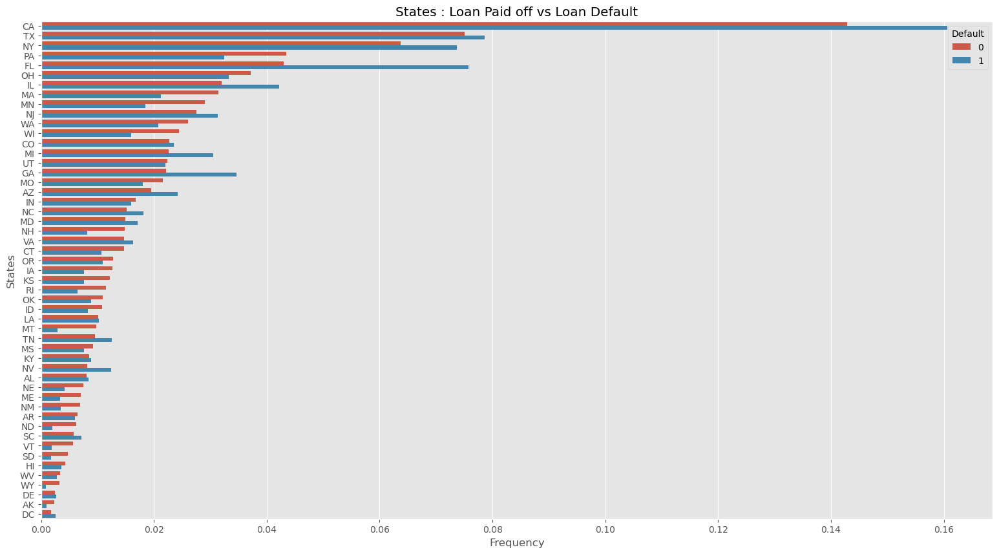

In [27]:
indu_status =(
    df_f['State']
    .groupby(df_f['Default'])
    .value_counts(normalize = True)
    .rename('Frequency')
    .to_frame()
    .reset_index()
)
#Plot
fig, ax = plt.subplots(figsize = (19,10))

sns.barplot(data = indu_status,
            x = 'Frequency',
            y = 'State',
            hue = 'Default',
            ax = ax
            )

ax.set(xlabel = 'Frequency',
       ylabel = 'States',
       title =  'States : Loan Paid off vs Loan Default'
       );


In [140]:
df_f.head(10)

,State,NAICS,Term,NoEmp,NewExist,DisbursementDate,DisbursementGross,BalanceGross,MIS_Status,GrAppv,SBA_Appv,Default,Backed_by_real_estate,Recession,Portion_%,NAICS_2,default_rate_category,NAICS_Category
0,IN,451120,84,4,2.0,1999-02-28,60000.0,0.0,P I F,60000.0,48000.0,0,0,0,0.80,45,Medium,Retail_Trade
1,IN,722410,60,2,2.0,1997-05-31,40000.0,0.0,P I F,40000.0,32000.0,0,0,0,0.80,72,Medium,Accommodation_Food_Services
2,IN,621210,180,7,1.0,1997-12-31,287000.0,0.0,P I F,287000.0,215250.0,0,0,0,0.75,62,Medium,Health_Care_Social_Assistance
3,CT,332721,120,19,1.0,1997-06-30,517000.0,0.0,P I F,517000.0,387750.0,0,0,0,0.75,33,Medium,Manufacturing
4,FL,811118,84,1,2.0,1998-06-30,45000.0,0.0,P I F,45000.0,36000.0,0,0,0,0.80,81,High,Other_Services_Except_Public_Administration
5,FL,721310,297,2,2.0,1997-07-31,305000.0,0.0,P I F,305000.0,228750.0,0,1,0,0.75,72,High,Accommodation_Food_Services
6,NC,811111,84,1,2.0,1998-02-23,70000.0,0.0,P I F,70000.0,56000.0,0,0,0,0.80,81,High,Other_Services_Except_Public_Administration
7,IL,235950,60,24,1.0,1997-11-30,150000.0,0.0,P I F,300000.0,225000.0,0,0,0,0.75,23,High,Construction
8,NC,445299,162,2,2.0,2006-03-31,253400.0,0.0,P I F,253400.0,190050.0,0,0,0,0.75,44,High,Retail_Trade
9,OK,421330,12,5,2.0,1997-09-30,350000.0,0.0,P I F,350000.0,262500.0,0,0,0,0.75,42,Medium,Wholesale_Trade


In [141]:
df_f.columns

Index(['State', 'NAICS', 'Term', 'NoEmp', 'NewExist', 'DisbursementDate',
       'DisbursementGross', 'BalanceGross', 'MIS_Status', 'GrAppv', 'SBA_Appv',
       'Default', 'Backed_by_real_estate', 'Recession', 'Portion_%', 'NAICS_2',
       'default_rate_category', 'NAICS_Category'],
      dtype='object')

In [142]:
df_model = df_f[[
        'State', 'Term', 'NoEmp', 'NewExist',
       'DisbursementGross', 'BalanceGross', 'GrAppv', 'SBA_Appv',
       'Default', 'Backed_by_real_estate', 'Recession', 'Portion_%', 'NAICS_2',
       'default_rate_category' 
       #'NAICS', 'DisbursementDate', 'MIS_Status'
       ]].copy()

In [143]:
df_model.head()

,State,Term,NoEmp,NewExist,DisbursementGross,BalanceGross,GrAppv,SBA_Appv,Default,Backed_by_real_estate,Recession,Portion_%,NAICS_2,default_rate_category,NAICS_Category
0,IN,84,4,2.0,60000.0,0.0,60000.0,48000.0,0,0,0,0.80,45,Medium,Retail_Trade
1,IN,60,2,2.0,40000.0,0.0,40000.0,32000.0,0,0,0,0.80,72,Medium,Accommodation_Food_Services
2,IN,180,7,1.0,287000.0,0.0,287000.0,215250.0,0,0,0,0.75,62,Medium,Health_Care_Social_Assistance
3,CT,120,19,1.0,517000.0,0.0,517000.0,387750.0,0,0,0,0.75,33,Medium,Manufacturing
4,FL,84,1,2.0,45000.0,0.0,45000.0,36000.0,0,0,0,0.80,81,High,Other_Services_Except_Public_Administration


In [144]:
df_model.dtypes

State                      object
Term                        int64
NoEmp                       int64
NewExist                  float64
DisbursementGross         float64
BalanceGross              float64
GrAppv                    float64
SBA_Appv                  float64
Default                     int64
Backed_by_real_estate       int64
Recession                   int64
Portion_%                 float64
NAICS_2                     int64
default_rate_category    category
NAICS_Category             object
dtype: object

In [145]:
# Select all columns with float64 type
float_columns = df_model.select_dtypes(include=['float64']).columns

# Convert each column of type float64 to int individually
for col in float_columns:
    df_model[col] = df_model[col].fillna(0).astype(int)

# Verify the changes
print(df_model.dtypes)





State                      object
Term                        int64
NoEmp                       int64
NewExist                    int64
DisbursementGross           int64
BalanceGross                int64
GrAppv                      int64
SBA_Appv                    int64
Default                     int64
Backed_by_real_estate       int64
Recession                   int64
Portion_%                   int64
NAICS_2                     int64
default_rate_category    category
NAICS_Category             object
dtype: object


In [146]:
df_model.columns

Index(['State', 'Term', 'NoEmp', 'NewExist', 'DisbursementGross',
       'BalanceGross', 'GrAppv', 'SBA_Appv', 'Default',
       'Backed_by_real_estate', 'Recession', 'Portion_%', 'NAICS_2',
       'default_rate_category', 'NAICS_Category'],
      dtype='object')

In [147]:
df_2 = df_model[[#'State', 
       'Term', 'NoEmp', 'NewExist', 'DisbursementGross',
       'BalanceGross', 'GrAppv', 'SBA_Appv', 'Default',
       'Backed_by_real_estate', 'Recession', 'Portion_%', 'NAICS_2', 'default_rate_category'
       ]].copy()

In [148]:
# Select the categorical variables
categorical_columns2 = ['default_rate_category']

# Convert categorical variables to dummies (one-hot encoding)
df_2 = pd.get_dummies(df_2, columns=categorical_columns2, dtype=int)

# Verify the changes
#df_model2.head(20)


In [150]:
print(df_2.shape)
df_2.head(10)

(693481, 15)


,Term,NoEmp,NewExist,DisbursementGross,BalanceGross,GrAppv,SBA_Appv,Default,Backed_by_real_estate,Recession,Portion_%,NAICS_2,default_rate_category_Low,default_rate_category_Medium,default_rate_category_High
0,84,4,2,60000,0,60000,48000,0,0,0,0,45,0,1,0
1,60,2,2,40000,0,40000,32000,0,0,0,0,72,0,1,0
2,180,7,1,287000,0,287000,215250,0,0,0,0,62,0,1,0
3,120,19,1,517000,0,517000,387750,0,0,0,0,33,0,1,0
4,84,1,2,45000,0,45000,36000,0,0,0,0,81,0,0,1
5,297,2,2,305000,0,305000,228750,0,1,0,0,72,0,0,1
6,84,1,2,70000,0,70000,56000,0,0,0,0,81,0,0,1
7,60,24,1,150000,0,300000,225000,0,0,0,0,23,0,0,1
8,162,2,2,253400,0,253400,190050,0,0,0,0,44,0,0,1
9,12,5,2,350000,0,350000,262500,0,0,0,0,42,0,1,0


In [336]:
df_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 693481 entries, 0 to 693480
Data columns (total 15 columns):
 #   Column                        Non-Null Count   Dtype
---  ------                        --------------   -----
 0   Term                          693481 non-null  int64
 1   NoEmp                         693481 non-null  int64
 2   NewExist                      693481 non-null  int64
 3   DisbursementGross             693481 non-null  int64
 4   BalanceGross                  693481 non-null  int64
 5   GrAppv                        693481 non-null  int64
 6   SBA_Appv                      693481 non-null  int64
 7   Default                       693481 non-null  int64
 8   Backed_by_real_estate         693481 non-null  int64
 9   Recession                     693481 non-null  int64
 10  Portion_%                     693481 non-null  int64
 11  NAICS_2                       693481 non-null  int64
 12  default_rate_category_Low     693481 non-null  int64
 13  default_rate_c

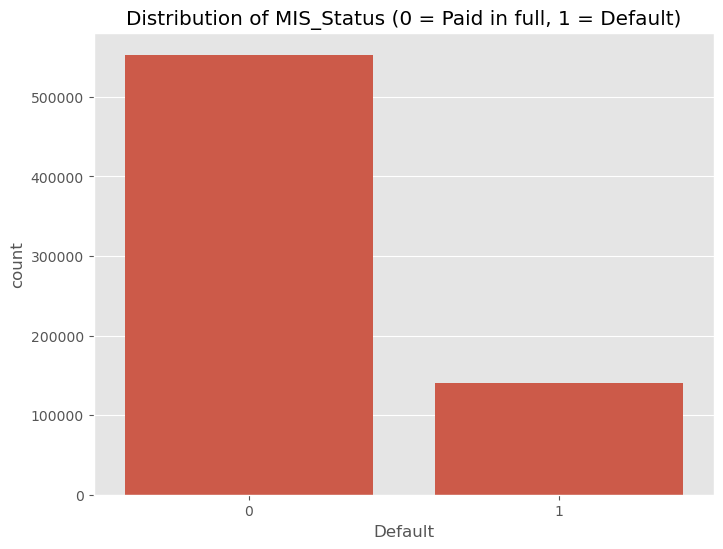

In [337]:
# Plot the distribution of the target variable 'MIS_Status_Binary'
plt.figure(figsize=(8, 6))
sns.countplot(x='Default', data=df_2)
plt.title("Distribution of MIS_Status (0 = Paid in full, 1 = Default)")
plt.show()


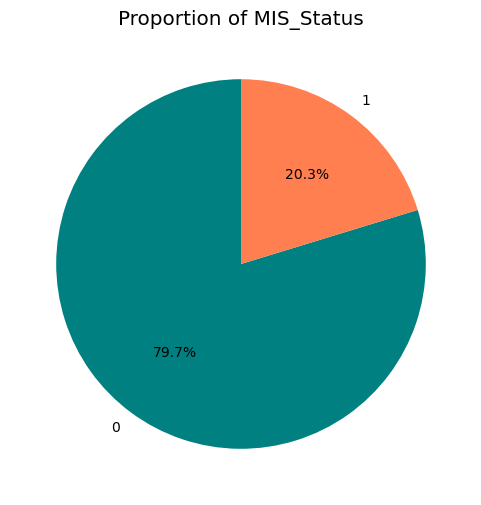

In [330]:
# Question 1:-Distribution of MIS_Status Plot
status_counts = df_2['Default'].value_counts()

# Plot
plt.figure(figsize=(6, 6))
plt.pie(status_counts, labels=status_counts.index, autopct='%1.1f%%', startangle=90, colors=['teal', 'coral'])
plt.title('Proportion of MIS_Status')
plt.show()

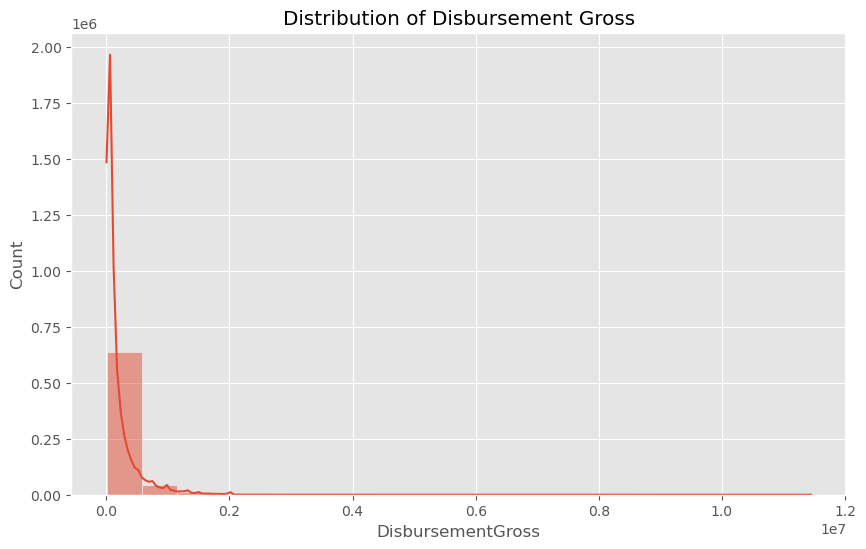

In [332]:
plt.figure(figsize=(10, 6))
sns.histplot(df_2['DisbursementGross'], bins=20, kde=True)
plt.title('Distribution of Disbursement Gross')
plt.show()

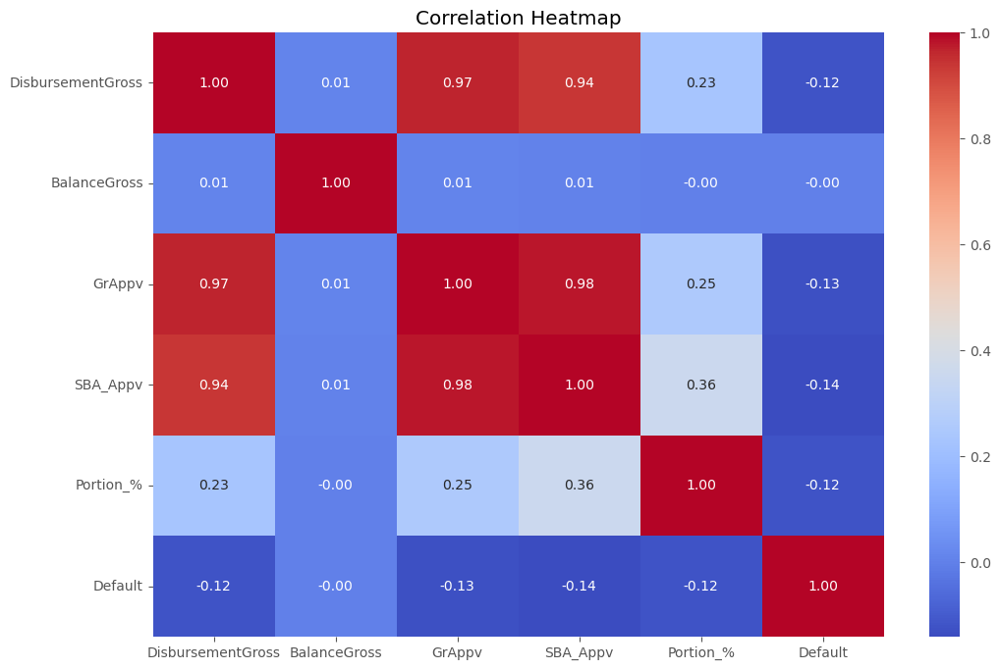

In [333]:
#Correlation Heatmap among variables
plt.figure(figsize=(12, 8))
corr_matrix = df_2[['DisbursementGross', 'BalanceGross', 'GrAppv', 'SBA_Appv', 'Portion_%','Default']].corr()
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Heatmap')
plt.show()

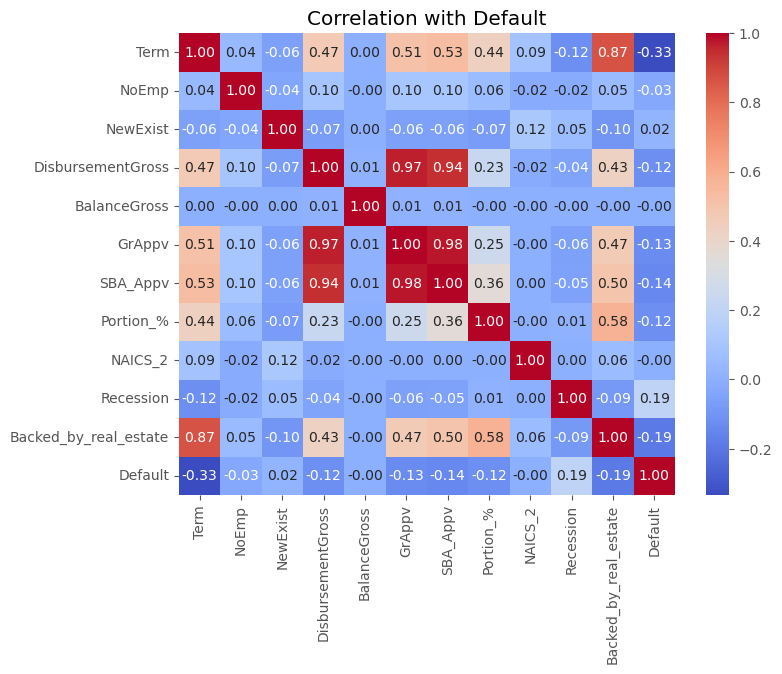

In [335]:
# Selecting numerical columns
numerical_columns = df_2.select_dtypes(include=['int64', 'float64']).columns

# Select numerical columns for correlation
numerical_cols = ['Term', 'NoEmp', 'NewExist', 'DisbursementGross', 'BalanceGross', 'GrAppv', 
                  'SBA_Appv', 'Portion_%', 'NAICS_2','Recession','Backed_by_real_estate']  # Add any other numerical columns you want

# Compute correlation matrix, including the encoded 'default_rate_category'
corr_matrix = df_2[numerical_cols + ['Default']].corr()

# Plotting the heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', cbar=True)
plt.title('Correlation with Default')
plt.show()

In [219]:
weights = [0.5 if x == 1 else 0.2 for x in df_2.Default]
df_sampled2 = df_2.sample(100000, weights=weights)

#df_sampled = df_model2.sample(n=100000, random_state=42)

In [339]:
print(df_sampled2['Default'].value_counts())
print(df_sampled2['Default'].value_counts(normalize=True) * 100)

Default
0    63138
1    36862
Name: count, dtype: int64
Default
0    63.138
1    36.862
Name: proportion, dtype: float64


In [340]:
df_sampled2.head(10)

,Term,NoEmp,NewExist,DisbursementGross,BalanceGross,GrAppv,SBA_Appv,Default,Backed_by_real_estate,Recession,Portion_%,NAICS_2,default_rate_category_Low,default_rate_category_Medium,default_rate_category_High
596776,84,2,1,50000,0,50000,25000,0,0,0,0,62,0,1,0
437489,300,3,1,451000,0,451000,338250,0,1,0,0,62,0,1,0
513639,84,2,1,140000,0,90000,45000,0,0,0,0,44,0,1,0
682948,24,23,1,350000,0,300000,150000,0,0,0,0,81,0,1,0
37121,60,15,2,20000,0,20000,10000,0,0,1,0,72,0,1,0
435482,300,72,1,1333000,0,1333000,999750,0,1,0,0,32,0,1,0
4508,84,1,2,30000,0,30000,15000,0,0,0,0,62,0,1,0
560575,37,1,1,25000,0,25000,12500,1,0,0,0,42,0,1,0
85027,102,2,2,932000,0,932000,699000,1,0,0,0,45,0,1,0
203204,240,1,1,384000,0,384000,384000,0,1,1,1,62,0,1,0


In [341]:
# Split the data into train and validation sets (80% training, 20% validation)
target = 'Default'
X2 = df_sampled2.drop(columns=[target])
y2 = df_sampled2[target]

X_train2, X_val2, y_train2, y_val2 = train_test_split(X2, y2, test_size=0.2, random_state=42)




# KNN Classifier Model

In [315]:
# Normalize the predictors
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train2)
X_val_scaled = scaler.transform(X_val2)

# Train kNN model
knn = KNeighborsClassifier()
knn.fit(X_train_scaled, y_train2)

# Predict on the validation set
y_pred_knn = knn.predict(X_val_scaled)

# Generate classification report and confusion matrix
print("Classification Report (Validation Set):")
print(classification_report(y_val2, y_pred_knn))

# Confusion Matrix
print("Confusion Matrix (Validation Set):")
print(confusion_matrix(y_val2, y_pred_knn))

Classification Report (Validation Set):
              precision    recall  f1-score   support

           0       0.86      0.88      0.87     12610
           1       0.79      0.75      0.77      7390

    accuracy                           0.83     20000
   macro avg       0.82      0.82      0.82     20000
weighted avg       0.83      0.83      0.83     20000

Confusion Matrix (Validation Set):
[[11131  1479]
 [ 1846  5544]]


In [318]:
# Step 1: Predict probabilities for the positive class (1 - Default) on the training data
y_probs_train = knn.predict_proba(X_train_scaled)[:, 1]  # Predicted probabilities for training
disbursement_gross_values_train = df_sampled2.loc[X_train2.index, 'DisbursementGross'].values  # Match with training data indices

# Step 2: Define thresholds to evaluate
thresholds = np.arange(0, 1.01, 0.01)

# Initialize lists for storing total benefits, recalls, and F1-scores
total_benefits_train = []
recalls_train = []
f1_scores_train = []

# Step 3: Loop through thresholds to calculate benefits, recall, and F1-score
for threshold in thresholds:
    # Apply the current threshold to predict class labels
    y_pred_train = (y_probs_train >= threshold).astype(int)
    
    # Calculate total benefit for each loan
    total_benefit_train = 0
    for actual, predicted, loan in zip(y_train2, y_pred_train, disbursement_gross_values_train):
        if predicted == 0 and actual == 0:  # True Negative
            total_benefit_train += 0.05 * loan  # 5% benefit of DisbursementGross
        elif predicted == 0 and actual == 1:  # False Negative
            total_benefit_train -= 0.25 * loan  # 25% loss of DisbursementGross
        elif predicted == 1 and actual == 0:  # False Positive
            total_benefit_train += 0  # No cost/benefit
        elif predicted == 1 and actual == 1:  # True Positive
            total_benefit_train += 0  # No cost/benefit
    
    # Store total benefits for this threshold
    total_benefits_train.append(total_benefit_train)
    
    # Calculate recall and F1-score for this threshold
    recall = recall_score(y_train2, y_pred_train)
    f1 = f1_score(y_train2, y_pred_train)
    
    recalls_train.append(recall)
    f1_scores_train.append(f1)

# Step 4: Combine recall and F1-score to find the optimal threshold
combined_scores_train = [
    0.5 * recall + 0.5 * f1  # Adjust the weights to prioritize recall more if needed
    for recall, f1 in zip(recalls_train, f1_scores_train)
]

# Select the threshold with the highest combined score
optimal_idx_train = np.argmax(combined_scores_train)
optimal_threshold_train = thresholds[optimal_idx_train]

# Step 5: Print the results for the optimal threshold
print("Optimal Threshold (Maximized Recall and Benefit) for Training Data:", optimal_threshold_train)
print("Maximum Total Benefit at Optimal Threshold:", total_benefits_train[optimal_idx_train])
print("Recall at Optimal Threshold:", recalls_train[optimal_idx_train])
print("F1-Score at Optimal Threshold:", f1_scores_train[optimal_idx_train])

# Step 6: Evaluate the Model at the Optimal Threshold
y_pred_optimal_train = (y_probs_train >= optimal_threshold_train).astype(int)

# Confusion Matrix for Training Data
print("\nConfusion Matrix (Training Data with Optimal Threshold):")
print(confusion_matrix(y_train2, y_pred_optimal_train))

# Classification Report for Training Data
print("\nClassification Report (Training Data with Optimal Threshold):")
print(classification_report(y_train2, y_pred_optimal_train))


Optimal Threshold (Maximized Recall and Benefit) for Training Data: 0.01
Maximum Total Benefit at Optimal Threshold: 358209491.59999967
Recall at Optimal Threshold: 0.9998982084690554
F1-Score at Optimal Threshold: 0.7833853924370308

Confusion Matrix (Training Data with Optimal Threshold):
[[34234 16294]
 [    3 29469]]

Classification Report (Training Data with Optimal Threshold):
              precision    recall  f1-score   support

           0       1.00      0.68      0.81     50528
           1       0.64      1.00      0.78     29472

    accuracy                           0.80     80000
   macro avg       0.82      0.84      0.80     80000
weighted avg       0.87      0.80      0.80     80000



In [319]:
# Step 1: Predict probabilities for the positive class (1) on the validation data
y_probs_val = knn.predict_proba(X_val_scaled)[:, 1]  # Predicted probabilities for validation

# Step 2: Apply the optimal threshold obtained from the training set
y_pred_optimal_val = (y_probs_val >= optimal_threshold_train).astype(int)

# Step 4: Confusion Matrix and Classification Report
print("\nConfusion Matrix (Validation Data):")
print(confusion_matrix(y_val2, y_pred_optimal_val))

print("\nClassification Report (Validation Data):")
print(classification_report(y_val2, y_pred_optimal_val))



Confusion Matrix (Validation Data):
[[8059 4551]
 [ 483 6907]]

Classification Report (Validation Data):
              precision    recall  f1-score   support

           0       0.94      0.64      0.76     12610
           1       0.60      0.93      0.73      7390

    accuracy                           0.75     20000
   macro avg       0.77      0.79      0.75     20000
weighted avg       0.82      0.75      0.75     20000



## Logistic Regression Model

In [302]:
# Scale training and testing data
scaler = StandardScaler()
X_train_scaled2 = scaler.fit_transform(X_train2)  # Fit and transform on training set
X_val_scaled2 = scaler.transform(X_val2)  # Transform on test set

# Lasso (L1 Regularization)
log_reg_lasso = LogisticRegression(class_weight='balanced', random_state=42, penalty='l1', C=10, solver='liblinear', max_iter=1000)
log_reg_lasso.fit(X_train_scaled2, y_train2)

# Ridge (L2 Regularization)
log_reg_ridge = LogisticRegression(class_weight='balanced', random_state=42, penalty='l2', C=10, solver='liblinear', max_iter=1000)
log_reg_ridge.fit(X_train_scaled2, y_train2)

# ElasticNet (Combination of L1 and L2)
log_reg_en = LogisticRegression(class_weight='balanced', random_state=42, penalty='elasticnet', l1_ratio=0.5, C=10, solver='saga', max_iter=1000)
log_reg_en.fit(X_train_scaled2, y_train2)

# Get predictions for the validation set for each model
y_pred_lasso = log_reg_lasso.predict(X_val_scaled2)
y_pred_ridge = log_reg_ridge.predict(X_val_scaled2)
y_pred_en = log_reg_en.predict(X_val_scaled2)

# Generate and print classification reports
print("Classification Report (Validation Data) - Lasso:")
print(classification_report(y_val2, y_pred_lasso))

print("Classification Report (Validation Data) - Ridge:")
print(classification_report(y_val2, y_pred_ridge))

print("Classification Report (Validation Data) - ElasticNet:")
print(classification_report(y_val2, y_pred_en))

Classification Report (Validation Data) - Lasso:
              precision    recall  f1-score   support

           0       0.87      0.75      0.80     12610
           1       0.65      0.81      0.72      7390

    accuracy                           0.77     20000
   macro avg       0.76      0.78      0.76     20000
weighted avg       0.79      0.77      0.77     20000

Classification Report (Validation Data) - Ridge:
              precision    recall  f1-score   support

           0       0.87      0.75      0.80     12610
           1       0.65      0.81      0.72      7390

    accuracy                           0.77     20000
   macro avg       0.76      0.78      0.76     20000
weighted avg       0.79      0.77      0.77     20000

Classification Report (Validation Data) - ElasticNet:
              precision    recall  f1-score   support

           0       0.87      0.74      0.80     12610
           1       0.65      0.81      0.72      7390

    accuracy                  

In [304]:
# Define the parameter grid for Lasso (L1 Regularization)
param_grid_lasso = {
    'penalty': ['l1'],
    'C': [0.01, 0.1, 1, 10, 100],
    'solver': ['liblinear'],
    'max_iter': [1000]
}

# Initialize GridSearchCV for Lasso
grid_search_lasso = GridSearchCV(LogisticRegression(class_weight='balanced', random_state=42),
                                 param_grid_lasso,
                                 scoring='f1',  # Use 'accuracy', or you can use other scoring metrics
                                 cv=3)  # 5-fold cross-validation

# Fit the Lasso model
grid_search_lasso.fit(X_train_scaled2, y_train2)

# Print the best parameters and best score
print("Best parameters for Lasso (L1) regularization:", grid_search_lasso.best_params_)
print("Best score for Lasso (L1) regularization:", grid_search_lasso.best_score_)

# Get predictions using the best model
y_pred_lasso_best = grid_search_lasso.best_estimator_.predict(X_val_scaled2)

# Print classification report for Lasso
print("Classification Report (Validation Data) - Lasso:")
print(classification_report(y_val2, y_pred_lasso_best))

# Show the coefficients of the best Lasso model
print('Parameters of Best Lasso (L1) Model:')
print('Intercept:', np.round(grid_search_lasso.best_estimator_.intercept_[0], decimals=3))
print('Coefficients for Predictors:')
pd.DataFrame({'Coeff:': np.round(grid_search_lasso.best_estimator_.coef_[0], decimals=3)}, index=X2.columns)


Best parameters for Lasso (L1) regularization: {'C': 100, 'max_iter': 1000, 'penalty': 'l1', 'solver': 'liblinear'}
Best score for Lasso (L1) regularization: 0.7170969033917919
Classification Report (Validation Data) - Lasso:
              precision    recall  f1-score   support

           0       0.87      0.75      0.80     12610
           1       0.65      0.81      0.72      7390

    accuracy                           0.77     20000
   macro avg       0.76      0.78      0.76     20000
weighted avg       0.79      0.77      0.77     20000

Parameters of Best Lasso (L1) Model:
Intercept: -0.376
Coefficients for Predictors:


,Coeff:
Term,-2.315
NoEmp,-0.461
NewExist,0.045
DisbursementGross,-0.560
BalanceGross,-0.022
GrAppv,1.408
SBA_Appv,-0.531
Backed_by_real_estate,1.013
Recession,0.417
Portion_%,-0.291


In [305]:
# Define the parameter grid for Ridge (L2 Regularization)
param_grid_ridge = {
    'penalty': ['l2'],
    'C': [0.01, 0.1, 1, 10, 100],
    'solver': ['liblinear'],
    'max_iter': [1000]
}

# Initialize GridSearchCV for Ridge
grid_search_ridge = GridSearchCV(LogisticRegression(class_weight='balanced', random_state=42),
                                 param_grid_ridge,
                                 scoring='f1',  # Use 'accuracy', or you can use other scoring metrics
                                 cv=3)  # 5-fold cross-validation

# Fit the Ridge model
grid_search_ridge.fit(X_train_scaled2, y_train2)

# Print the best parameters and best score
print("Best parameters for Ridge (L2) regularization:", grid_search_ridge.best_params_)
print("Best score for Ridge (L2) regularization:", grid_search_ridge.best_score_)

# Get predictions using the best model
y_pred_ridge_best = grid_search_ridge.best_estimator_.predict(X_val_scaled2)

# Print classification report for Ridge
print("Classification Report (Validation Data) - Ridge:")
print(classification_report(y_val2, y_pred_ridge_best))

# Show the coefficients of the best Ridge model
print('Parameters of Best Ridge (L2) Model:')
print('Intercept:', np.round(grid_search_ridge.best_estimator_.intercept_[0], decimals=3))
print('Coefficients for Predictors:')
pd.DataFrame({'Coeff:': np.round(grid_search_ridge.best_estimator_.coef_[0], decimals=3)}, index=X2.columns)


Best parameters for Ridge (L2) regularization: {'C': 10, 'max_iter': 1000, 'penalty': 'l2', 'solver': 'liblinear'}
Best score for Ridge (L2) regularization: 0.7171463850493529
Classification Report (Validation Data) - Ridge:
              precision    recall  f1-score   support

           0       0.87      0.75      0.80     12610
           1       0.65      0.81      0.72      7390

    accuracy                           0.77     20000
   macro avg       0.76      0.78      0.76     20000
weighted avg       0.79      0.77      0.77     20000

Parameters of Best Ridge (L2) Model:
Intercept: -0.376
Coefficients for Predictors:


,Coeff:
Term,-2.315
NoEmp,-0.461
NewExist,0.045
DisbursementGross,-0.561
BalanceGross,-0.007
GrAppv,1.411
SBA_Appv,-0.533
Backed_by_real_estate,1.013
Recession,0.417
Portion_%,-0.290


In [ ]:
# Define the parameter grid for ElasticNet Regularization
param_grid_en = {
    'penalty': ['elasticnet'],
    'C': [0.01, 0.1, 1, 10, 100],
    'l1_ratio': [0.1, 0.5, 0.9],  # Mix of L1 and L2 regularization
    'solver': ['saga'],
    'max_iter': [10000]
}

# Initialize GridSearchCV for ElasticNet
grid_search_en = GridSearchCV(LogisticRegression(class_weight='balanced', random_state=42),
                              param_grid_en,
                              scoring='f1',  # Use 'accuracy', or you can use other scoring metrics
                              cv=3)  # 5-fold cross-validation

# Fit the ElasticNet model
grid_search_en.fit(X_train_scaled2, y_train2)

# Print the best parameters and best score
print("Best parameters for ElasticNet regularization:", grid_search_en.best_params_)
print("Best score for ElasticNet regularization:", grid_search_en.best_score_)

# Get predictions using the best model
y_pred_en_best = grid_search_en.best_estimator_.predict(X_val_scaled2)

# Print classification report for ElasticNet
print("Classification Report (Validation Data) - ElasticNet:")
print(classification_report(y_val2, y_pred_en_best))

# Show the coefficients of the best ElasticNet model
print('Parameters of Best ElasticNet Model:')
print('Intercept:', np.round(grid_search_en.best_estimator_.intercept_[0], decimals=3))
print('Coefficients for Predictors:')
pd.DataFrame({'Coeff:': np.round(grid_search_en.best_estimator_.coef_[0], decimals=3)}, index=X2.columns)


In [300]:
# Predict probabilities for the positive class (1 - Default) on the training data
y_probs_train = log_reg2.predict_proba(X_train_scaled2)[:, 1]  # Predicted probabilities for training
disbursement_gross_values_train = df_sampled2['DisbursementGross'].values  # Ensure alignment with training data

#  Define thresholds to evaluate
thresholds = np.arange(0, 1.01, 0.01)

# Initialize lists for storing total benefits, recalls, and F1-scores
total_benefits_train = []
recalls_train = []
f1_scores_train = []

#  Loop through thresholds to calculate benefits, recall, and F1-score
for threshold in thresholds:
    # Apply the current threshold to predict class labels
    y_pred_train = (y_probs_train >= threshold).astype(int)
    
    # Calculate total benefit for each loan
    total_benefit_train = 0
    for actual, predicted, loan in zip(y_train2, y_pred_train, disbursement_gross_values_train):
        if predicted == 0 and actual == 0:  # True Negative
            total_benefit_train += 0.05 * loan  # 5% benefit of DisbursementGross
        elif predicted == 0 and actual == 1:  # False Negative
            total_benefit_train -= 0.25 * loan  # No cost/benefit
        elif predicted == 1 and actual == 0:  # False Positive
            total_benefit_train += 0  # 25% cost of DisbursementGross
        elif predicted == 1 and actual == 1:  # True Positive
            total_benefit_train += 0  # No cost/benefit
    
    # Store total benefits for this threshold
    total_benefits_train.append(total_benefit_train)
 
    # Calculate recall and F1-score for this threshold
    recall = recall_score(y_train2, y_pred_train)
    f1 = f1_score(y_train2, y_pred_train)
    
    recalls_train.append(recall)
    f1_scores_train.append(f1)

#  Combine recall and F1-score to find optimal threshold
# Combine total benefits, recall, and F1-score by assigning weights
combined_scores_train = [
    0.5 * recall + 0.5 * f1  # Adjust the weights if needed to prioritize recall more
    for recall, f1 in zip(recalls_train, f1_scores_train)
]

# Select the threshold with the highest combined score
optimal_idx_train = np.argmax(combined_scores_train)
optimal_threshold_train = thresholds[optimal_idx_train]

# Print the results for the optimal threshold
print("Optimal Threshold (Maximized Recall and Benefit) for Training Data:", optimal_threshold_train)
print("Maximum Total Benefit at Optimal Threshold:", total_benefits_train[optimal_idx_train])
print("Recall at Optimal Threshold:", recalls_train[optimal_idx_train])
print("F1-Score at Optimal Threshold:", f1_scores_train[optimal_idx_train])

# Plot the results
plt.figure(figsize=(12, 8))

#  Evaluate the Model at the Optimal Threshold (Optional)
y_pred_optimal_train = (y_probs_train >= optimal_threshold_train).astype(int)

# Confusion Matrix for Training Data
print("Confusion Matrix (Training Data with Optimal Threshold):")
print(confusion_matrix(y_train2, y_pred_optimal_train))

# Classification Report for Training Data
print("Classification Report (Training Data with Optimal Threshold):")
print(classification_report(y_train2, y_pred_optimal_train))


Optimal Threshold (Maximized Recall and Benefit) for Training Data: 0.37
Maximum Total Benefit at Optimal Threshold: 145216140.10000002
Recall at Optimal Threshold: 0.902178338762215
F1-Score at Optimal Threshold: 0.6936773587612997
Confusion Matrix (Training Data with Optimal Threshold):
[[29928 20600]
 [ 2883 26589]]
Classification Report (Training Data with Optimal Threshold):
              precision    recall  f1-score   support

           0       0.91      0.59      0.72     50528
           1       0.56      0.90      0.69     29472

    accuracy                           0.71     80000
   macro avg       0.74      0.75      0.71     80000
weighted avg       0.78      0.71      0.71     80000



<Figure size 1200x800 with 0 Axes>

In [311]:
#  Predict probabilities for the positive class (1 - Default)
y_probs_train_lasso = grid_search_lasso.best_estimator_.predict_proba(X_train_scaled2)[:, 1]
disbursement_gross_values_train = df_sampled2['DisbursementGross'].values  # Ensure alignment with training data

#  Define thresholds to evaluate
thresholds = np.arange(0, 1.01, 0.01)

# Initialize lists for storing total benefits, recalls, and F1-scores
total_benefits_train_lasso = []
recalls_train_lasso = []
f1_scores_train_lasso = []

#  Loop through thresholds to calculate benefits, recall, and F1-score
for threshold in thresholds:
    y_pred_train_lasso = (y_probs_train_lasso >= threshold).astype(int)
    
    total_benefit_train = 0
    for actual, predicted, loan in zip(y_train2, y_pred_train_lasso, disbursement_gross_values_train):
        if predicted == 0 and actual == 0:
            total_benefit_train += 0.05 * loan
        elif predicted == 0 and actual == 1:
            total_benefit_train -= 0.25 * loan
        elif predicted == 1 and actual == 0:
            total_benefit_train += 0
        elif predicted == 1 and actual == 1:
            total_benefit_train += 0
    
    total_benefits_train_lasso.append(total_benefit_train)
    recalls_train_lasso.append(recall_score(y_train2, y_pred_train_lasso))
    f1_scores_train_lasso.append(f1_score(y_train2, y_pred_train_lasso))

#  Find optimal threshold
combined_scores_train_lasso = [
    0.5 * recall + 0.5 * f1 for recall, f1 in zip(recalls_train_lasso, f1_scores_train_lasso)
]

optimal_idx_train_lasso = np.argmax(combined_scores_train_lasso)
optimal_threshold_train_lasso = thresholds[optimal_idx_train_lasso]

# Print the results for the optimal threshold
print("Optimal Threshold for Lasso:", optimal_threshold_train_lasso)
print("Maximum Total Benefit for Lasso:", total_benefits_train_lasso[optimal_idx_train_lasso])
print("Recall for Lasso:", recalls_train_lasso[optimal_idx_train_lasso])
print("F1-Score for Lasso:", f1_scores_train_lasso[optimal_idx_train_lasso])

#  Evaluate performance at optimal threshold
y_pred_optimal_lasso = (y_probs_train_lasso >= optimal_threshold_train_lasso).astype(int)
print("\nConfusion Matrix (Lasso at Optimal Threshold):")
print(confusion_matrix(y_train2, y_pred_optimal_lasso))
print("\nClassification Report (Lasso at Optimal Threshold):")
print(classification_report(y_train2, y_pred_optimal_lasso))


Optimal Threshold for Lasso: 0.37
Maximum Total Benefit for Lasso: 145128690.10000002
Recall for Lasso: 0.9021444082519001
F1-Score for Lasso: 0.6936693669366937

Confusion Matrix (Lasso at Optimal Threshold):
[[29929 20599]
 [ 2884 26588]]

Classification Report (Lasso at Optimal Threshold):
              precision    recall  f1-score   support

           0       0.91      0.59      0.72     50528
           1       0.56      0.90      0.69     29472

    accuracy                           0.71     80000
   macro avg       0.74      0.75      0.71     80000
weighted avg       0.78      0.71      0.71     80000



In [312]:
# Step 1: Predict probabilities for the positive class
y_probs_train_ridge = grid_search_ridge.best_estimator_.predict_proba(X_train_scaled2)[:, 1]

# Initialize lists
total_benefits_train_ridge = []
recalls_train_ridge = []
f1_scores_train_ridge = []

# Step 2: Loop through thresholds
for threshold in thresholds:
    y_pred_train_ridge = (y_probs_train_ridge >= threshold).astype(int)
    
    total_benefit_train = 0
    for actual, predicted, loan in zip(y_train2, y_pred_train_ridge, disbursement_gross_values_train):
        if predicted == 0 and actual == 0:
            total_benefit_train += 0.05 * loan
        elif predicted == 0 and actual == 1:
            total_benefit_train -= 0.25 * loan
        elif predicted == 1 and actual == 0:
            total_benefit_train += 0
        elif predicted == 1 and actual == 1:
            total_benefit_train += 0
    
    total_benefits_train_ridge.append(total_benefit_train)
    recalls_train_ridge.append(recall_score(y_train2, y_pred_train_ridge))
    f1_scores_train_ridge.append(f1_score(y_train2, y_pred_train_ridge))

# Step 4: Find optimal threshold
combined_scores_train_ridge = [
    0.5 * recall + 0.5 * f1 for recall, f1 in zip(recalls_train_ridge, f1_scores_train_ridge)
]

optimal_idx_train_ridge = np.argmax(combined_scores_train_ridge)
optimal_threshold_train_ridge = thresholds[optimal_idx_train_ridge]

print("\nOptimal Threshold for Ridge:", optimal_threshold_train_ridge)
print("Maximum Total Benefit for Ridge:", total_benefits_train_ridge[optimal_idx_train_ridge])
print("Recall for Ridge:", recalls_train_ridge[optimal_idx_train_ridge])
print("F1-Score for Ridge:", f1_scores_train_ridge[optimal_idx_train_ridge])

# Step 5: Evaluate performance at optimal threshold
y_pred_optimal_ridge = (y_probs_train_ridge >= optimal_threshold_train_ridge).astype(int)
print("\nConfusion Matrix (Ridge at Optimal Threshold):")
print(confusion_matrix(y_train2, y_pred_optimal_ridge))
print("\nClassification Report (Ridge at Optimal Threshold):")
print(classification_report(y_train2, y_pred_optimal_ridge))



Optimal Threshold for Ridge: 0.37
Maximum Total Benefit for Ridge: 145216140.10000002
Recall for Ridge: 0.902178338762215
F1-Score for Ridge: 0.6936773587612997

Confusion Matrix (Ridge at Optimal Threshold):
[[29928 20600]
 [ 2883 26589]]

Classification Report (Ridge at Optimal Threshold):
              precision    recall  f1-score   support

           0       0.91      0.59      0.72     50528
           1       0.56      0.90      0.69     29472

    accuracy                           0.71     80000
   macro avg       0.74      0.75      0.71     80000
weighted avg       0.78      0.71      0.71     80000



In [314]:
# Step 1: Predict probabilities for the positive class
y_probs_train_en = log_reg_en.predict_proba(X_train_scaled2)[:, 1]

# Initialize lists
total_benefits_train_en = []
recalls_train_en = []
f1_scores_train_en = []

# Step 2: Loop through thresholds
for threshold in thresholds:
    y_pred_train_en = (y_probs_train_en >= threshold).astype(int)
    
    total_benefit_train = 0
    for actual, predicted, loan in zip(y_train2, y_pred_train_en, disbursement_gross_values_train):
        if predicted == 0 and actual == 0:
            total_benefit_train += 0.05 * loan
        elif predicted == 0 and actual == 1:
            total_benefit_train -= 0.25 * loan
        elif predicted == 1 and actual == 0:
            total_benefit_train += 0
        elif predicted == 1 and actual == 1:
            total_benefit_train += 0
    
    total_benefits_train_en.append(total_benefit_train)
    recalls_train_en.append(recall_score(y_train2, y_pred_train_en))
    f1_scores_train_en.append(f1_score(y_train2, y_pred_train_en))

# Step 4: Find optimal threshold
combined_scores_train_en = [
    0.5 * recall + 0.5 * f1 for recall, f1 in zip(recalls_train_en, f1_scores_train_en)
]

optimal_idx_train_en = np.argmax(combined_scores_train_en)
optimal_threshold_train_en = thresholds[optimal_idx_train_en]

print("\nOptimal Threshold for ElasticNet:", optimal_threshold_train_en)
print("Maximum Total Benefit for ElasticNet:", total_benefits_train_en[optimal_idx_train_en])
print("Recall for ElasticNet:", recalls_train_en[optimal_idx_train_en])
print("F1-Score for ElasticNet:", f1_scores_train_en[optimal_idx_train_en])

# Step 5: Evaluate performance at optimal threshold
y_pred_optimal_en = (y_probs_train_en >= optimal_threshold_train_en).astype(int)
print("\nConfusion Matrix (ElasticNet at Optimal Threshold):")
print(confusion_matrix(y_train2, y_pred_optimal_en))
print("\nClassification Report (ElasticNet at Optimal Threshold):")
print(classification_report(y_train2, y_pred_optimal_en))



Optimal Threshold for ElasticNet: 0.37
Maximum Total Benefit for ElasticNet: 145254424.35000005
Recall for ElasticNet: 0.902178338762215
F1-Score for ElasticNet: 0.6934964332755181

Confusion Matrix (ElasticNet at Optimal Threshold):
[[29908 20620]
 [ 2883 26589]]

Classification Report (ElasticNet at Optimal Threshold):
              precision    recall  f1-score   support

           0       0.91      0.59      0.72     50528
           1       0.56      0.90      0.69     29472

    accuracy                           0.71     80000
   macro avg       0.74      0.75      0.71     80000
weighted avg       0.78      0.71      0.71     80000



# Classification Trees

## Single Tree

In [208]:
df_sampled2.head(10)

,Term,NoEmp,NewExist,DisbursementGross,BalanceGross,GrAppv,SBA_Appv,Default,Backed_by_real_estate,Recession,Portion_%,NAICS_2,default_rate_category_Low,default_rate_category_Medium,default_rate_category_High
567883,84,4,1,360000,0,360000,270000,0,0,0,0,81,0,1,0
47949,43,5,1,100000,0,100000,50000,1,0,0,0,52,0,1,0
609558,36,1,2,37500,0,37500,18750,0,0,0,0,62,1,0,0
231482,68,0,1,50000,0,50000,42500,1,0,1,0,44,0,1,0
553584,240,24,1,398000,0,398000,398000,0,1,0,1,72,0,1,0
154308,149,5,1,127877,0,127877,95908,1,0,0,0,32,1,0,0
603146,120,2,2,196860,0,196860,167331,0,0,0,0,81,0,1,0
38506,84,3,1,21510,0,10000,5000,0,0,0,0,62,0,1,0
518391,212,1,1,150000,0,150000,127500,1,0,0,0,53,0,0,1
237670,6,1,2,50000,0,50000,42500,1,0,1,0,44,0,1,0


In [221]:
df_sampled2.columns

Index(['Term', 'NoEmp', 'NewExist', 'DisbursementGross', 'BalanceGross',
       'GrAppv', 'SBA_Appv', 'Default', 'Backed_by_real_estate', 'Recession',
       'Portion_%', 'NAICS_2', 'default_rate_category_Low',
       'default_rate_category_Medium', 'default_rate_category_High'],
      dtype='object')

In [188]:

# Apply DecisionTreeClassifier() to create a full classification tree.
# The tree will grow fully without a max_depth restriction.
classTree = DecisionTreeClassifier(max_depth=20, 
        min_impurity_decrease=0, min_samples_split=100)
classTree.fit(X_train1 , y_train1)

plotDecisionTree(classTree, feature_names=X_train1.columns)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.879391 to fit


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.570416 to fit


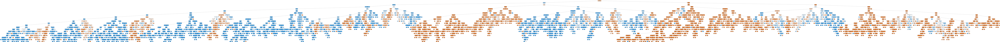

In [223]:
classTree = DecisionTreeClassifier(max_depth=20, 
        min_impurity_decrease=0, min_samples_split=80)
classTree.fit(X_train2 , y_train2)

plotDecisionTree(classTree, feature_names=X_train2.columns)

In [206]:
# Confusion matrices for smaller classification tree. 

# Identify  and display confusion matrix for training partition. 
print('Training Partition for Smaller Tree')
classificationSummary(y_train2, classTree.predict(X_train2))

# Identify  and display confusion matrix for validation partition. 
print()
print('Validation Partition for Smaller Tree')
classificationSummary(y_val2, classTree.predict(X_val2))

Training Partition for Smaller Tree
Confusion Matrix (Accuracy 0.9254)

       Prediction
Actual     0     1
     0 47378  3103
     1  2865 26654

Validation Partition for Smaller Tree
Confusion Matrix (Accuracy 0.9113)

       Prediction
Actual     0     1
     0 11791   965
     1   809  6435


/Users/osheen/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


In [243]:
# Make predictions
y_pred2 = classTree.predict(X_val2)
y_prob2 = classTree.predict_proba(X_val2)[:, 1]  # Get probabilities for the positive class (1)


# Generate classification report
print("Classification Report:")
print(classification_report(y_val2, y_pred2, target_names=["No Default(0)", "Default(1)"]))

print("Confusion Matrix on Validation Set:")
print(confusion_matrix(y_val2, y_pred2))


Classification Report:
               precision    recall  f1-score   support

No Default(0)       0.93      0.92      0.92     12610
   Default(1)       0.86      0.88      0.87      7390

     accuracy                           0.91     20000
    macro avg       0.90      0.90      0.90     20000
 weighted avg       0.91      0.91      0.91     20000

Confusion Matrix on Validation Set:
[[11589  1021]
 [  873  6517]]


In [262]:
import numpy as np
from sklearn.metrics import recall_score

# Define the thresholds and list to store total benefits and recall values
thresholds = np.arange(0, 1.01, 0.01)
total_benefits = []
recalls = []

# Extract DisbursementGross values from the dataframe
disbursement_gross_values = df_sampled2['DisbursementGross'].values

# Get predicted probabilities from the trained model
y_probs = classTree.predict_proba(X_train2)[:, 1]

# Loop through each threshold to calculate the total benefit and recall
for threshold in thresholds:
    # Predict using the current threshold
    y_pred = (y_probs >= threshold).astype(int)
    
    total_benefit = 0

    # Calculate the cost/benefit for each loan in the dataset
    for actual, predicted, loan in zip(y_train2, y_pred, disbursement_gross_values):
        if predicted == 0 and actual == 0:  # True Negative (Loan approved, repaid)
            total_benefit += 0.05 * loan  # 5% benefit of DisbursementGross
        elif predicted == 0 and actual == 1:  # False Negative (Loan approved, defaulted)
            total_benefit -= 0.25 * loan  # 25% cost of DisbursementGross
        elif predicted == 1 and actual == 1:  # True Positive (Loan denied, defaulted)
            total_benefit += 0  # No gain or loss, loan denied, avoided loss
        elif predicted == 1 and actual == 0:  # False Positive (Loan denied, no default)
            total_benefit += 0  # 5% opportunity loss of DisbursementGross

    # Append total benefit for this threshold
    total_benefits.append(total_benefit)
    
    # Calculate recall for this threshold
    recall = recall_score(y_train2, y_pred)
    recalls.append(recall)

# Combine total benefits and recall by selecting the threshold with the highest recall
# This prioritizes recall for predicting class 1 (defaults)
combined_scores = [total_benefit + recall for total_benefit, recall in zip(total_benefits, recalls)]

# Find the threshold with the highest combined score
optimal_idx = np.argmax(combined_scores)
optimal_threshold = thresholds[optimal_idx]

# Print the results
print("Optimal Threshold (Maximized Recall):", optimal_threshold)
print("Maximum Total Benefit:", total_benefits[optimal_idx])
print("Recall at Optimal Threshold:", recalls[optimal_idx])


Optimal Threshold (Maximized Recall): 0.17
Maximum Total Benefit: 355353814.75
Recall at Optimal Threshold: 0.9748235613463626


In [260]:
# Get predicted probabilities for the validation dataset
y_probs_val = classTree.predict_proba(X_val2)[:, 1]  # Probability of default (1)

# Apply the optimal threshold (0.33) to classify the loans
y_pred_val = (y_probs_val >= 0.17).astype(int)

# Interpret the predictions for the validation set
# 1 = Deny loan (predicted default)
# 0 = Approve loan (predicted no default)

# Optionally, add the prediction to the validation dataframe
#df_sampled2['Loan Decision'] = np.where(y_pred_val == 1, "Deny", "Approve")


In [261]:


# Evaluate the model performance on the validation set
print("Classification Report on Validation Set:")
print(classification_report(y_val2, y_pred_val))

print("Confusion Matrix on Validation Set:")
print(confusion_matrix(y_val2, y_pred_val))


Classification Report on Validation Set:
              precision    recall  f1-score   support

           0       0.97      0.84      0.90     12610
           1       0.77      0.96      0.86      7390

    accuracy                           0.88     20000
   macro avg       0.87      0.90      0.88     20000
weighted avg       0.90      0.88      0.88     20000

Confusion Matrix on Validation Set:
[[10550  2060]
 [  329  7061]]


In [204]:
# Start with initial guess for parameters.
param_grid = {
    'max_depth': [10, 20, 30, 40],  
    'min_impurity_decrease': [0, 0.0005, 0.001, 0.005, 0.01], 
    'min_samples_split': [20, 40, 60, 80, 100],
}

# Apply GridSearchCV() fucntion for various combinations of
# DecisionTreeClassifier() initial parameters. cv=5 means that
# 5-fold cross-validation is used in this case, and n_jobs=-1 
# means that the availalbe computer memory (CPU) will be 
# used to make calculations faster. 
gridSearch_init = GridSearchCV(DecisionTreeClassifier(), 
                   param_grid, cv=3, n_jobs=1)
gridSearch_init.fit(X_train2, y_train2)

# Display best initial paramenters of classification tree. 
print(f'Initial score:{gridSearch_init.best_score_:.4f}')
print('Initial parameters: ', gridSearch_init.best_params_)

Initial score:0.9084
Initial parameters:  {'max_depth': 20, 'min_impurity_decrease': 0, 'min_samples_split': 80}


## Random Forrest

In [246]:
X2 = df_sampled2.drop(columns=[target])
y2 = df_sampled2[target]

X_train2, X_val2, y_train2, y_val2 = train_test_split(X2, y2, test_size=0.2, random_state=42)

In [247]:
# Apply RandomForestClassifier() function to develop a combined
# (ensemple) classification tree using Random Forest algorithm.
rf = RandomForestClassifier(n_estimators=500, random_state=1)
rf.fit(X_train2, y_train2)

# Display number of nodes in Random Forest trees.
n_nodes = rf.estimators_[0].tree_.node_count
print('Number of Nodes in Tree in Random Forest:', n_nodes)

Number of Nodes in Tree in Random Forest: 18637


In [248]:
# Make predictions on the validation dataset
y_pred_rf = rf.predict(X_val2)

# Generate classification report
print("Classification Report for Random Forest:")
print(classification_report(y_val2, y_pred_rf, target_names=["No Default(0)", "Default(1)"]))


Classification Report for Random Forest:
               precision    recall  f1-score   support

No Default(0)       0.92      0.92      0.92     12610
   Default(1)       0.87      0.86      0.86      7390

     accuracy                           0.90     20000
    macro avg       0.89      0.89      0.89     20000
 weighted avg       0.90      0.90      0.90     20000



Optimal Threshold (Maximized Recall and Balanced F1-score) for Training Data: 0.41000000000000003
Maximum Total Benefit (Training Data) at Optimal Threshold: 454162621.39999944
Recall at Optimal Threshold: 0.9994231813246471
F1-Score at Optimal Threshold: 0.9987962225123346


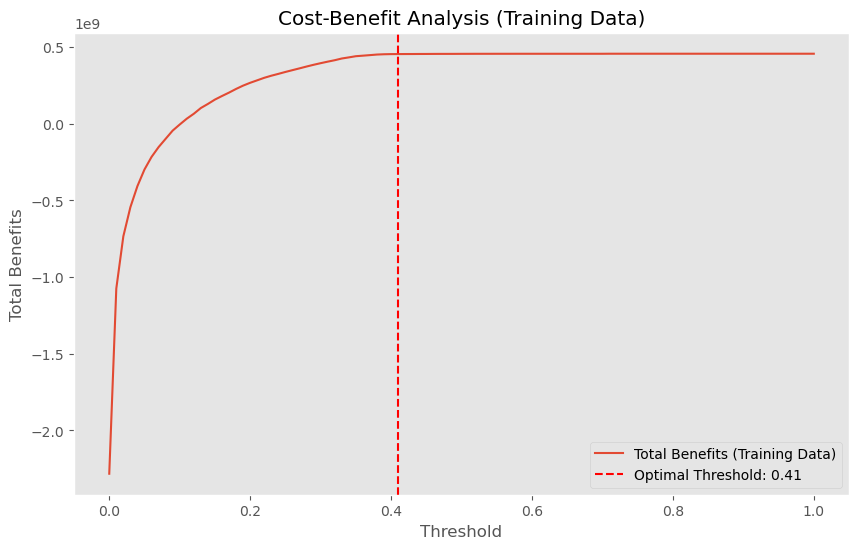

In [274]:
# Predict probabilities for the positive class (1 - Default) on the training data
y_probs_train = rf.predict_proba(X_train2)[:, 1]  # Predicted probabilities for the training set

# Extract DisbursementGross values
disbursement_gross_values_train = df_sampled2['DisbursementGross'].values  # Ensure alignment with training data

# Define thresholds to evaluate
thresholds = np.arange(0, 1.01, 0.01)
total_benefits_train = []
recalls_train = []
f1_scores_train = []

# Loop through thresholds
for threshold in thresholds:
    # Predict using the current threshold
    y_pred_train = (y_probs_train >= threshold).astype(int)
    
    total_benefit_train = 0

    # Calculate cost/benefit for each loan
    for actual, predicted, loan in zip(y_train2, y_pred_train, disbursement_gross_values_train):
        if predicted == 0 and actual == 0:  # True Negative (Predicted: Paid in full, Actual: Paid in full)
            total_benefit_train += 0.05 * loan
        elif predicted == 0 and actual == 1:  # False Negative (Predicted: Paid in full, Actual: Default)
            total_benefit_train += 0  # No cost/benefit
        elif predicted == 1 and actual == 0:  # False Positive (Predicted: Default, Actual: Paid in full)
            total_benefit_train -= 0.25 * loan
        elif predicted == 1 and actual == 1:  # True Positive (Predicted: Default, Actual: Default)
            total_benefit_train += 0  # No cost/benefit
    
    total_benefits_train.append(total_benefit_train)

    # Calculate recall for this threshold
    recall = recall_score(y_train2, y_pred_train)
    recalls_train.append(recall)

    # Calculate F1-score for this threshold
    f1 = f1_score(y_train2, y_pred_train)
    f1_scores_train.append(f1)

# Now we want to prioritize recall but also maintain a reasonable F1-score
# We can use a weighted combination of recall and F1-score to guide the threshold selection
combined_scores_train = [
    0.7 * recall + 0.3 * f1  # Here, you can adjust the weights to prioritize recall more
    for recall, f1 in zip(recalls_train, f1_scores_train)
]

# Find the threshold with the highest combined score
optimal_idx_train = np.argmax(combined_scores_train)
optimal_threshold_train = thresholds[optimal_idx_train]

# Print the results
print("Optimal Threshold (Maximized Recall and Balanced F1-score) for Training Data:", optimal_threshold_train)
print("Maximum Total Benefit (Training Data) at Optimal Threshold:", total_benefits_train[optimal_idx_train])
print("Recall at Optimal Threshold:", recalls_train[optimal_idx_train])
print("F1-Score at Optimal Threshold:", f1_scores_train[optimal_idx_train])

# Optional: Plot the total benefits vs. thresholds
plt.figure(figsize=(10, 6))
plt.plot(thresholds, total_benefits_train, label='Total Benefits (Training Data)')
plt.axvline(optimal_threshold_train, color='r', linestyle='--', label=f'Optimal Threshold: {optimal_threshold_train:.2f}')
plt.title('Cost-Benefit Analysis (Training Data)')
plt.xlabel('Threshold')
plt.ylabel('Total Benefits')
plt.legend()
plt.grid()
plt.show()


In [275]:
# Classify using the optimal threshold for the training set
y_pred_optimal_train = (y_probs_train >= optimal_threshold_train).astype(int)

# Optional: Evaluate performance metrics on the training set with the new threshold
print("Classification Report (Training Data with Optimal Threshold):")
print(classification_report(y_train2, y_pred_optimal_train))


Classification Report (Training Data with Optimal Threshold):
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     50528
           1       1.00      1.00      1.00     29472

    accuracy                           1.00     80000
   macro avg       1.00      1.00      1.00     80000
weighted avg       1.00      1.00      1.00     80000



In [276]:
# For validation/test data
y_probs_val = rf.predict_proba(X_val2)[:, 1]  # Get predicted probabilities for validation/test
y_pred_optimal_val = (y_probs_val >= optimal_threshold_train).astype(int)  # Apply optimal threshold

# Classification report on validation/test data
print("Classification Report (Validation/Test Data with Optimal Threshold):")
print(classification_report(y_val2, y_pred_optimal_val))  # Replace y_val2 with y_test2 for test data


Classification Report (Validation/Test Data with Optimal Threshold):
              precision    recall  f1-score   support

           0       0.94      0.90      0.92     12610
           1       0.83      0.90      0.87      7390

    accuracy                           0.90     20000
   macro avg       0.89      0.90      0.89     20000
weighted avg       0.90      0.90      0.90     20000



In [278]:
# Confusion Matrix for the validation/test data
cm = confusion_matrix(y_val2, y_pred_optimal_val)  # Replace y_val2 with y_test2 for test data

print("Confusion Matrix (Validation/Test Data with Optimal Threshold):")
print(cm)



Confusion Matrix (Validation/Test Data with Optimal Threshold):
[[11292  1318]
 [  742  6648]]


In [279]:
# Identify  and display confusion matrix for validation partition. 
print('Validation Partition for Random Forests')
classificationSummary(y_val2, y_pred_optimal_val)

Validation Partition for Random Forests
Confusion Matrix (Accuracy 0.8970)

       Prediction
Actual     0     1
     0 11292  1318
     1   742  6648


In [277]:
# Confusion matrices for Random Forest classification. 

# Identify  and display confusion matrix for training partition. 
print('Training Partition for Random Forests')
classificationSummary(y_train2, rf.predict(X_train2))

# Identify  and display confusion matrix for validation partition. 
print()
print('Validation Partition for Random Forests')
classificationSummary(y_val2, rf.predict(X_val2))

Training Partition for Random Forests
Confusion Matrix (Accuracy 0.9991)

       Prediction
Actual     0     1
     0 50514    14
     1    56 29416

Validation Partition for Random Forests
Confusion Matrix (Accuracy 0.8995)

       Prediction
Actual     0     1
     0 11636   974
     1  1035  6355


In [280]:
# For Random Forest, identify variable importance scores. 
importances = rf.feature_importances_
std = np.std([tree.feature_importances_ for tree in rf.estimators_], axis=0)

# Develop data frame for variable importance. The table data is sorted
# in descending order (ascending=False).
score_df = pd.DataFrame({'Feature': X_train2.columns, 'Importance': importances, 'Std': std})
score_df = score_df.sort_values('Importance', ascending=False)

# Display variable importance for Random Forest results. 
print('Variable Importance Scores for Random Forest')
print(score_df)

Variable Importance Scores for Random Forest
                         Feature  Importance       Std
0                           Term    0.545986  0.040194
6                       SBA_Appv    0.091169  0.026141
3              DisbursementGross    0.084293  0.009283
5                         GrAppv    0.068333  0.019247
1                          NoEmp    0.062972  0.004944
10                       NAICS_2    0.062121  0.004715
8                      Recession    0.027521  0.008640
7          Backed_by_real_estate    0.018645  0.020087
2                       NewExist    0.010824  0.002025
11     default_rate_category_Low    0.009997  0.003997
13    default_rate_category_High    0.006897  0.002506
9                      Portion_%    0.005964  0.006726
12  default_rate_category_Medium    0.005268  0.002279
4                   BalanceGross    0.000010  0.000021


## Boosted Tree

In [283]:
import lightgbm as lgb
from sklearn.metrics import classification_report, confusion_matrix

# Initialize the model
lgbm_model = lgb.LGBMClassifier(n_estimators=500, learning_rate=0.05, random_state=1)

# Fit the model on the training data
lgbm_model.fit(X_train2, y_train2)

# Predict the class labels (0 or 1) on the validation/test data
y_pred_lgbm = lgbm_model.predict(X_val2)  # This gives the class labels directly

# Confusion Matrix
cm_lgbm = confusion_matrix(y_val2, y_pred_lgbm)

# Print confusion matrix
print("Confusion Matrix (Validation/Test Data - LightGBM):")
print(cm_lgbm)

# Classification report on validation/test data
print("\nClassification Report (Validation/Test Data - LightGBM):")
print(classification_report(y_val2, y_pred_lgbm))  # Replace y_val2 with y_test2 for test data


[LightGBM] [Info] Number of positive: 29472, number of negative: 50528
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004733 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1215
[LightGBM] [Info] Number of data points in the train set: 80000, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.368400 -> initscore=-0.539087
[LightGBM] [Info] Start training from score -0.539087
Confusion Matrix (Validation/Test Data - LightGBM):
[[11806   804]
 [  730  6660]]

Classification Report (Validation/Test Data - LightGBM):
              precision    recall  f1-score   support

           0       0.94      0.94      0.94     12610
           1       0.89      0.90      0.90      7390

    accuracy                           0.92     20000
   macro avg       0.92      0.92      0.92     20000
weighted avg       0.92      

Optimal Threshold (Prioritizing Recall, Balanced with F1-Score) for Training Data: 0.19
Maximum Total Benefit (Training Data) at Optimal Threshold: 71990299.39999992
Recall at Optimal Threshold: 0.973093105320304
F1-Score at Optimal Threshold: 0.8796429776400944


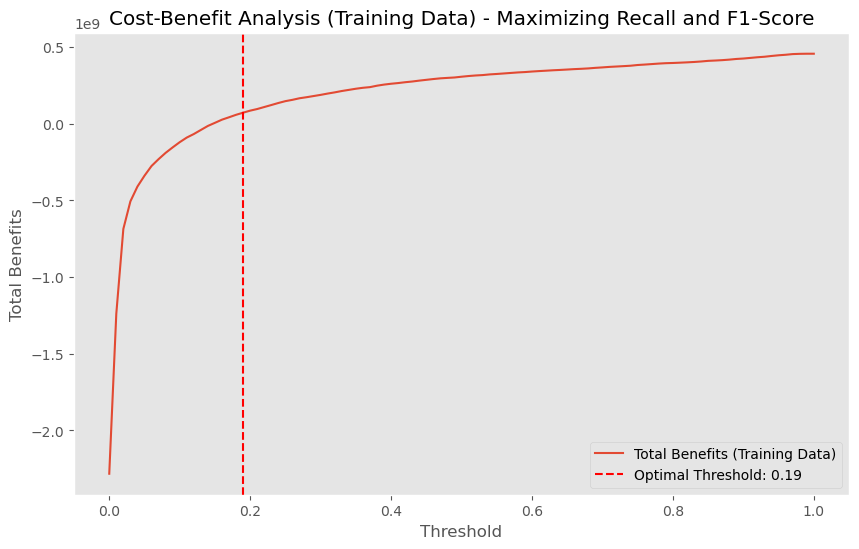

Classification Report (Validation/Test Data with Optimal Threshold):
              precision    recall  f1-score   support

           0       0.97      0.86      0.91     12610
           1       0.80      0.96      0.87      7390

    accuracy                           0.90     20000
   macro avg       0.89      0.91      0.89     20000
weighted avg       0.91      0.90      0.90     20000



In [285]:
# Step 2: Predict probabilities for the positive class (default = 1)
y_probs_train = lgbm_model.predict_proba(X_train2)[:, 1]  # Get predicted probabilities

# Step 3: Extract DisbursementGross values
disbursement_gross_values_train = df_sampled2['DisbursementGross'].values  # Ensure alignment with training data

# Step 4: Define thresholds to evaluate
thresholds = np.arange(0, 1.01, 0.01)
total_benefits_train = []
recalls_train = []
f1_scores_train = []

# Step 5: Loop through thresholds and calculate net benefit, recall, and F1-Score
for threshold in thresholds:
    # Predict using the current threshold
    y_pred_train = (y_probs_train >= threshold).astype(int)
    
    total_benefit_train = 0

    # Calculate cost/benefit for each loan
    for actual, predicted, loan in zip(y_train2, y_pred_train, disbursement_gross_values_train):
        if predicted == 0 and actual == 0:  # True Negative (Predicted: Paid in full, Actual: Paid in full)
            total_benefit_train += 0.05 * loan  # 5% benefit of DisbursementGross
        elif predicted == 0 and actual == 1:  # False Negative (Predicted: Paid in full, Actual: Default)
            total_benefit_train += 0  # No cost/benefit
        elif predicted == 1 and actual == 0:  # False Positive (Predicted: Default, Actual: Paid in full)
            total_benefit_train -= 0.25 * loan  # 25% cost of DisbursementGross
        elif predicted == 1 and actual == 1:  # True Positive (Predicted: Default, Actual: Default)
            total_benefit_train += 0  # No cost/benefit

    total_benefits_train.append(total_benefit_train)

    # Calculate recall and F1-Score for this threshold
    recall = recall_score(y_train2, y_pred_train)
    recalls_train.append(recall)
    f1 = f1_score(y_train2, y_pred_train)
    f1_scores_train.append(f1)

# Step 6: Combine total benefits, recall, and F1-Score using weighted combination
# Here, we prioritize recall more (e.g., 70% recall, 30% F1-score)
combined_scores_train = [
    0.7 * recall + 0.3 * f1  # Adjust the weights to prioritize recall more
    for recall, f1 in zip(recalls_train, f1_scores_train)
]

# Step 7: Find the optimal threshold that maximizes the combined score
optimal_idx_train = np.argmax(combined_scores_train)
optimal_threshold_train = thresholds[optimal_idx_train]

# Step 8: Print the results
print("Optimal Threshold (Prioritizing Recall, Balanced with F1-Score) for Training Data:", optimal_threshold_train)
print("Maximum Total Benefit (Training Data) at Optimal Threshold:", total_benefits_train[optimal_idx_train])
print("Recall at Optimal Threshold:", recalls_train[optimal_idx_train])
print("F1-Score at Optimal Threshold:", f1_scores_train[optimal_idx_train])

# Step 9: Optional: Plot the total benefits vs. thresholds
plt.figure(figsize=(10, 6))
plt.plot(thresholds, total_benefits_train, label='Total Benefits (Training Data)')
plt.axvline(optimal_threshold_train, color='r', linestyle='--', label=f'Optimal Threshold: {optimal_threshold_train:.2f}')
plt.title('Cost-Benefit Analysis (Training Data) - Maximizing Recall and F1-Score')
plt.xlabel('Threshold')
plt.ylabel('Total Benefits')
plt.legend()
plt.grid()
plt.show()

# Step 10: Use the optimal threshold on the validation/test set for predictions
y_probs_val = lgbm_model.predict_proba(X_val2)[:, 1]  # Predict probabilities on validation data
y_pred_optimal_val = (y_probs_val >= optimal_threshold_train).astype(int)  # Apply optimal threshold

# Classification report on validation/test data
print("Classification Report (Validation/Test Data with Optimal Threshold):")
print(classification_report(y_val2, y_pred_optimal_val))  # Replace y_val2 with y_test2 for test data

## Neural Networks

In [308]:
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier

# Standardize the features (important for neural networks)
scaler = StandardScaler()
X_train2_scaled = scaler.fit_transform(X_train2)
X_val2_scaled = scaler.transform(X_val2)

# Initialize and configure the neural network model
# Single hidden layer with 10 nodes, logistic activation, and 'adam' solver
loan_clf = MLPClassifier(hidden_layer_sizes=(10,), activation='logistic', 
                         solver='adam', max_iter=10000, random_state=42)

# Train the model
loan_clf.fit(X_train2_scaled, y_train2)

# Display network structure with the final values of intercepts and weights
print('Final Intercepts for Neural Network Model:')
print(loan_clf.intercepts_)

print()
print('Network Weights for Neural Network Model:')
print(loan_clf.coefs_)




Final Intercepts for Neural Network Model:
[array([-0.24184628, -2.88046352,  3.72559301,  6.26220062,  0.59174562,
        0.74608156, -5.69630457,  0.54865692, -0.71928661, -2.71633845]), array([-1.08011718])]

Network Weights for Neural Network Model:
[array([[ 1.32690095e+01,  1.82795409e+00, -2.04135892e-01,
         4.54902880e+01, -2.10823997e+01,  3.18150888e-01,
        -1.54534866e+01,  1.19368446e+00,  3.72477821e+00,
         2.75006800e+00],
       [-6.30037504e-01,  4.77972150e-02,  4.45778231e-01,
        -1.00231892e+00, -2.53110193e-01, -1.56483467e-01,
         6.41032892e-01, -8.91041917e-01, -1.18020879e-01,
        -7.88225666e-03],
       [-2.30922188e-03,  2.20140214e-01,  4.02377424e-01,
        -9.86074447e-02, -2.40156268e-02, -5.46976733e-01,
         5.68042473e-02,  6.77985015e-02,  3.50945368e-01,
        -2.42854140e-01],
       [-2.32378204e+00, -1.04897167e+01, -8.11183818e-01,
         6.07242743e-01,  3.19075168e-01, -1.60764142e-01,
        -5.589633

Accuracy: 0.84

Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.86      0.87     12610
           1       0.77      0.79      0.78      7390

    accuracy                           0.84     20000
   macro avg       0.83      0.83      0.83     20000
weighted avg       0.84      0.84      0.84     20000



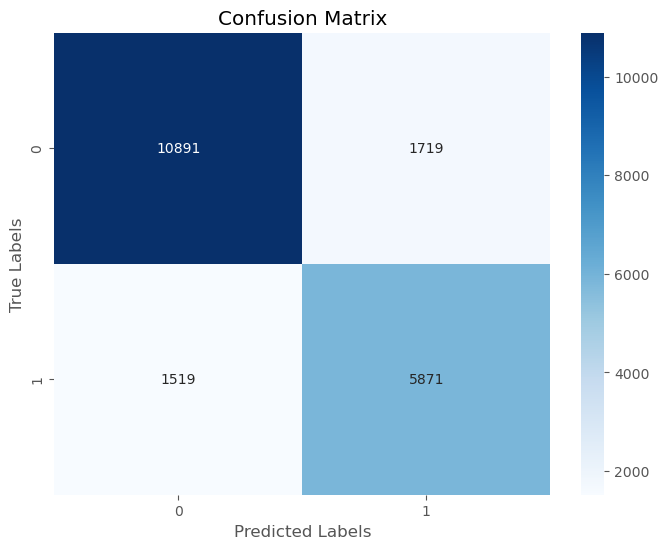

In [309]:
# Predict on validation data
y_val2_pred = loan_clf.predict(X_val2_scaled)

# Accuracy score
accuracy = accuracy_score(y_val2, y_val2_pred)
print(f"Accuracy: {accuracy:.2f}")

# Classification report
print("\nClassification Report:")
print(classification_report(y_val2, y_val2_pred))

# Confusion matrix
conf_matrix = confusion_matrix(y_val2, y_val2_pred)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=loan_clf.classes_, yticklabels=loan_clf.classes_)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

Optimal Threshold (Maximized Recall and Benefit) for Training Data: 0.19
Maximum Total Benefit at Optimal Threshold: 247109505.9500001
Recall at Optimal Threshold: 0.9435057003257329
F1-Score at Optimal Threshold: 0.7657377320041857


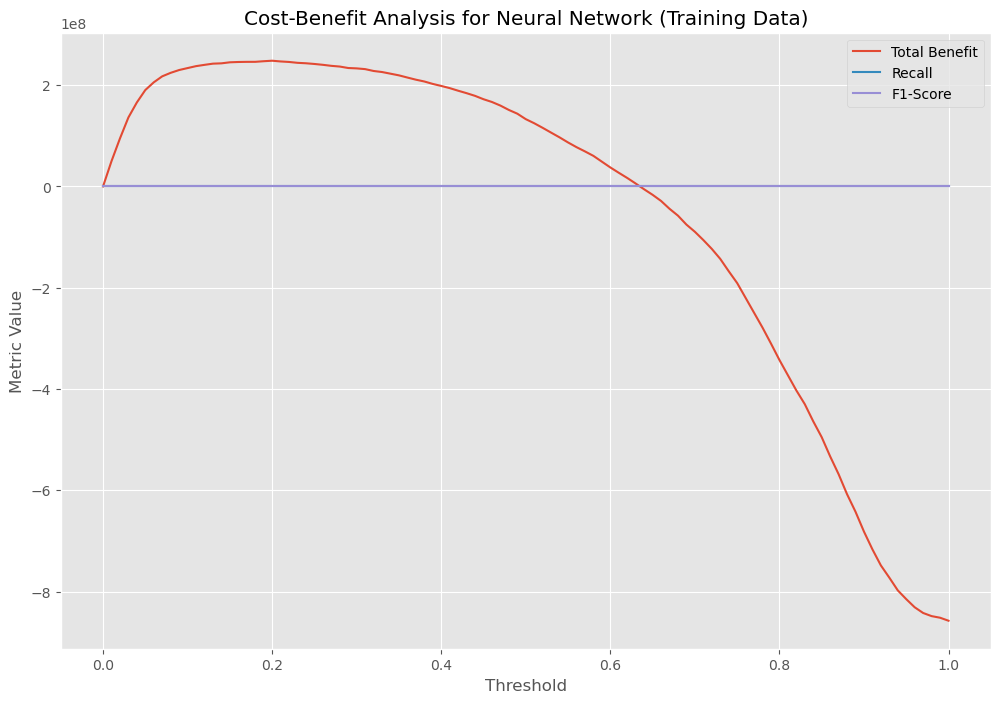

Confusion Matrix (Training Data with Optimal Threshold):
[[35179 15349]
 [ 1665 27807]]
Classification Report (Training Data with Optimal Threshold):
              precision    recall  f1-score   support

           0       0.95      0.70      0.81     50528
           1       0.64      0.94      0.77     29472

    accuracy                           0.79     80000
   macro avg       0.80      0.82      0.79     80000
weighted avg       0.84      0.79      0.79     80000



In [321]:
# Step 1: Predict probabilities for the positive class (1) on the training data
y_probs_train_nn = loan_clf.predict_proba(X_train2_scaled)[:, 1]  # Predicted probabilities for training
disbursement_gross_values_train = df_sampled2['DisbursementGross'].values  # Ensure alignment with training data

# Step 2: Define thresholds to evaluate
thresholds = np.arange(0, 1.01, 0.01)

# Initialize lists for storing total benefits, recalls, and F1-scores
total_benefits_train_nn = []
recalls_train_nn = []
f1_scores_train_nn = []

# Step 3: Loop through thresholds to calculate benefits, recall, and F1-score
for threshold in thresholds:
    # Apply the current threshold to predict class labels
    y_pred_train_nn = (y_probs_train_nn >= threshold).astype(int)
    
    # Calculate total benefit for each loan
    total_benefit_train_nn = 0
    for actual, predicted, loan in zip(y_train2, y_pred_train_nn, disbursement_gross_values_train):
        if predicted == 0 and actual == 0:  # True Negative
            total_benefit_train_nn += 0.05 * loan  # 5% benefit of DisbursementGross
        elif predicted == 0 and actual == 1:  # False Negative
            total_benefit_train_nn -= 0.25 * loan  # No cost/benefit
        elif predicted == 1 and actual == 0:  # False Positive
            total_benefit_train_nn += 0  # 25% cost of DisbursementGross
        elif predicted == 1 and actual == 1:  # True Positive
            total_benefit_train_nn += 0  # No cost/benefit
    
    # Store total benefits for this threshold
    total_benefits_train_nn.append(total_benefit_train_nn)
    
    # Calculate recall and F1-score for this threshold
    recall = recall_score(y_train2, y_pred_train_nn)
    f1 = f1_score(y_train2, y_pred_train_nn)
    
    recalls_train_nn.append(recall)
    f1_scores_train_nn.append(f1)

# Step 4: Combine recall and F1-score to find optimal threshold
combined_scores_train_nn = [
    0.5 * recall + 0.5 * f1  # Adjust weights to prioritize recall or F1 more
    for recall, f1 in zip(recalls_train_nn, f1_scores_train_nn)
]

# Step 5: Select the threshold with the highest combined score
optimal_idx_train_nn = np.argmax(combined_scores_train_nn)
optimal_threshold_train_nn = thresholds[optimal_idx_train_nn]

# Print the results for the optimal threshold
print("Optimal Threshold (Maximized Recall and Benefit) for Training Data:", optimal_threshold_train_nn)
print("Maximum Total Benefit at Optimal Threshold:", total_benefits_train_nn[optimal_idx_train_nn])
print("Recall at Optimal Threshold:", recalls_train_nn[optimal_idx_train_nn])
print("F1-Score at Optimal Threshold:", f1_scores_train_nn[optimal_idx_train_nn])

# Step 6: Plot the results (optional)
plt.figure(figsize=(12, 8))
plt.plot(thresholds, total_benefits_train_nn, label="Total Benefit")
plt.plot(thresholds, recalls_train_nn, label="Recall")
plt.plot(thresholds, f1_scores_train_nn, label="F1-Score")
plt.xlabel("Threshold")
plt.ylabel("Metric Value")
plt.title("Cost-Benefit Analysis for Neural Network (Training Data)")
plt.legend()
plt.grid(True)
plt.show()

# Step 7: Evaluate the Model at the Optimal Threshold (Optional)
y_pred_optimal_train_nn = (y_probs_train_nn >= optimal_threshold_train_nn).astype(int)

# Confusion Matrix for Training Data
print("Confusion Matrix (Training Data with Optimal Threshold):")
print(confusion_matrix(y_train2, y_pred_optimal_train_nn))

# Classification Report for Training Data
print("Classification Report (Training Data with Optimal Threshold):")
print(classification_report(y_train2, y_pred_optimal_train_nn))


In [322]:
# Use the probabilities predicted by the model on the validation set
y_probs_val = loan_clf.predict_proba(X_val2_scaled)[:, 1]  # Probabilities for the positive class (1)

# Apply the optimal threshold from the training set to classify
optimal_threshold = 0.19  # Replace with the threshold value you obtained
y_pred_val_optimal = (y_probs_val >= optimal_threshold).astype(int)

# Confusion Matrix for Validation Data
print("Confusion Matrix (Validation Data with Optimal Threshold):")
print(confusion_matrix(y_val2, y_pred_val_optimal))

# Classification Report for Validation Data
print("Classification Report (Validation Data with Optimal Threshold):")
print(classification_report(y_val2, y_pred_val_optimal))


Confusion Matrix (Validation Data with Optimal Threshold):
[[8714 3896]
 [ 441 6949]]
Classification Report (Validation Data with Optimal Threshold):
              precision    recall  f1-score   support

           0       0.95      0.69      0.80     12610
           1       0.64      0.94      0.76      7390

    accuracy                           0.78     20000
   macro avg       0.80      0.82      0.78     20000
weighted avg       0.84      0.78      0.79     20000



## Discriminant Analysis


In [323]:
# Standardize the features 
scaler = StandardScaler()
X_train2_scaled = scaler.fit_transform(X_train2)
X_val2_scaled = scaler.transform(X_val2)

# Initialize the LDA model
lda = LinearDiscriminantAnalysis()

# Fit the model on the scaled training data
lda.fit(X_train2_scaled, y_train2)

LinearDiscriminantAnalysis()

In [324]:


# Predictions for the training and validation sets
y_pred_train = lda.predict(X_train2_scaled)
y_pred_val = lda.predict(X_val2_scaled)

# Performance measures for the training set
print("\nConfusion Matrix (Training Set):")
print(confusion_matrix(y_train2, y_pred_train))
print("\nClassification Report (Training Set):")
print(classification_report(y_train2, y_pred_train))

# Performance measures for the validation set
print("\nConfusion Matrix (Validation Set):")
print(confusion_matrix(y_val2, y_pred_val))
print("\nClassification Report (Validation Set):")
print(classification_report(y_val2, y_pred_val))



Confusion Matrix (Training Set):
[[43448  7080]
 [10376 19096]]

Classification Report (Training Set):
              precision    recall  f1-score   support

           0       0.81      0.86      0.83     50528
           1       0.73      0.65      0.69     29472

    accuracy                           0.78     80000
   macro avg       0.77      0.75      0.76     80000
weighted avg       0.78      0.78      0.78     80000


Confusion Matrix (Validation Set):
[[10904  1706]
 [ 2597  4793]]

Classification Report (Validation Set):
              precision    recall  f1-score   support

           0       0.81      0.86      0.84     12610
           1       0.74      0.65      0.69      7390

    accuracy                           0.78     20000
   macro avg       0.77      0.76      0.76     20000
weighted avg       0.78      0.78      0.78     20000



In [328]:
# Step 1: Predict probabilities for the positive class (1 - Default) on the training set
y_probs_train = lda.predict_proba(X_train2_scaled)[:, 1]  # Probabilities for class 1
disbursement_gross_values_train = df_sampled2['DisbursementGross'].values  # Ensure alignment with training data

# Step 2: Define thresholds to evaluate
thresholds = np.arange(0, 1.01, 0.01)

# Initialize lists for storing total benefits, recalls, and F1-scores
total_benefits_train = []
recalls_train = []
f1_scores_train = []

# Step 3: Loop through thresholds to calculate benefits, recall, and F1-score
for threshold in thresholds:
    # Apply the current threshold to predict class labels
    y_pred_train = (y_probs_train >= threshold).astype(int)
    
    # Calculate total benefit for each loan
    total_benefit_train = 0
    for actual, predicted, loan in zip(y_train2, y_pred_train, disbursement_gross_values_train):
        if predicted == 0 and actual == 0:  # True Negative
            total_benefit_train += 0.05 * loan  # 5% benefit of DisbursementGross
        elif predicted == 0 and actual == 1:  # False Negative
            total_benefit_train -= 0.25 * loan  # 25% loss of DisbursementGross
        elif predicted == 1 and actual == 0:  # False Positive
            total_benefit_train += 0  # No cost/benefit
        elif predicted == 1 and actual == 1:  # True Positive
            total_benefit_train += 0  # No cost/benefit
    
    # Store total benefits for this threshold
    total_benefits_train.append(total_benefit_train)
    
    # Calculate recall and F1-score for this threshold
    recall = recall_score(y_train2, y_pred_train)
    f1 = f1_score(y_train2, y_pred_train)
    
    recalls_train.append(recall)
    f1_scores_train.append(f1)

# Step 4: Combine recall and F1-score to find the optimal threshold
combined_scores_train = [
    0.5 * recall + 0.5 * f1  # Adjust weights to prioritize recall or F1-score
    for recall, f1 in zip(recalls_train, f1_scores_train)
]

# Step 5: Select the threshold with the highest combined score
optimal_idx_train = np.argmax(combined_scores_train)
optimal_threshold_train = thresholds[optimal_idx_train]

# Print the results for the optimal threshold
print("Optimal Threshold (Maximized Recall and Benefit) for Training Data:", optimal_threshold_train)
print("Maximum Total Benefit at Optimal Threshold:", total_benefits_train[optimal_idx_train])
print("Recall at Optimal Threshold:", recalls_train[optimal_idx_train])
print("F1-Score at Optimal Threshold:", f1_scores_train[optimal_idx_train])

# Step 6: Evaluate performance on the validation set using the optimal threshold
y_probs_val = lda.predict_proba(X_val2_scaled)[:, 1]  # Probabilities for class 1 on validation set
y_pred_val = (y_probs_val >= optimal_threshold_train).astype(int)

# Calculate total benefit for the validation set
total_benefit_val = 0
disbursement_gross_values_val = df_sampled2['DisbursementGross'].values  # Ensure alignment with validation data
for actual, predicted, loan in zip(y_val2, y_pred_val, disbursement_gross_values_val):
    if predicted == 0 and actual == 0:  # True Negative
        total_benefit_val += 0.05 * loan  # 5% benefit of DisbursementGross
    elif predicted == 0 and actual == 1:  # False Negative
        total_benefit_val -= 0.25 * loan  # 25% loss of DisbursementGross
    elif predicted == 1 and actual == 0:  # False Positive
        total_benefit_val += 0  # No cost/benefit
    elif predicted == 1 and actual == 1:  # True Positive
        total_benefit_val += 0  # No cost/benefit

# Print validation results
print("\nPerformance on Validation Set:")
print("Total Benefit on Validation Set:", total_benefit_val)
print("\nConfusion Matrix (Validation Data with Optimal Threshold):")
print(confusion_matrix(y_val2, y_pred_val))
print("\nClassification Report (Validation Data with Optimal Threshold):")
print(classification_report(y_val2, y_pred_val))


Optimal Threshold (Maximized Recall and Benefit) for Training Data: 0.27
Maximum Total Benefit at Optimal Threshold: 150962776.04999983
Recall at Optimal Threshold: 0.9010247014115093
F1-Score at Optimal Threshold: 0.6973202211047359

Performance on Validation Set:
Total Benefit on Validation Set: 39191937.64999998

Confusion Matrix (Validation Data with Optimal Threshold):
[[7603 5007]
 [ 710 6680]]

Classification Report (Validation Data with Optimal Threshold):
              precision    recall  f1-score   support

           0       0.91      0.60      0.73     12610
           1       0.57      0.90      0.70      7390

    accuracy                           0.71     20000
   macro avg       0.74      0.75      0.71     20000
weighted avg       0.79      0.71      0.72     20000

